In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, r2_score, mean_squared_error
import wandb
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.metrics import hamming_loss

/usr/lib/python3/dist-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.25.2
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


### PART 1

##### DATASET ANALYSIS

In [2]:
data = pd.read_csv('WineQT.csv')
data = data.values
data = data[:, :-1]
# last column is the class label
labels = data[:, -1]
x = data[:, :-1]

# mean
mean = np.mean(x, axis=0)
print("Mean: ", mean)

# standard deviation
std = np.std(x, axis=0)
print("Standard Deviation: ", std)

# min
min = np.min(x, axis=0)
print("Min: ", min)

# max
max = np.max(x, axis=0)
print("Max: ", max)

Mean:  [ 8.31111111  0.53133858  0.26836395  2.53215223  0.08693263 15.61548556
 45.91469816  0.99673041  3.31101487  0.65770779 10.4421114 ]
Standard Deviation:  [1.74683037e+00 1.79554596e-01 1.96599794e-01 1.35532420e+00
 4.72466566e-02 1.02460011e+01 3.27677868e+01 1.92422483e-03
 1.56595513e-01 1.70324158e-01 1.08172210e+00]
Min:  [4.6     0.12    0.      0.9     0.012   1.      6.      0.99007 2.74
 0.33    8.4    ]
Max:  [ 15.9       1.58      1.       15.5       0.611    68.      289.
   1.00369   4.01      2.       14.9    ]


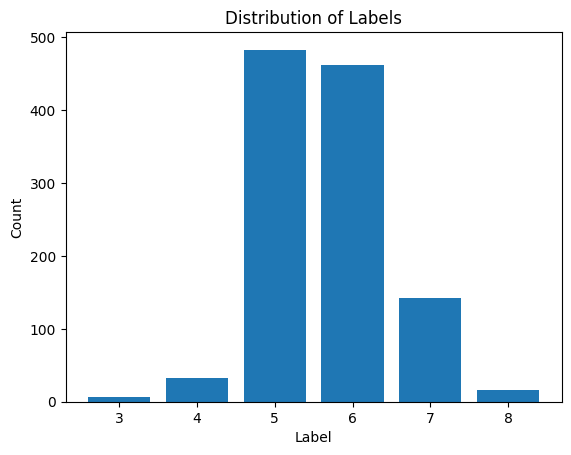

In [3]:
unique, counts = np.unique(labels, return_counts=True)
plt.bar(unique, counts)
plt.title("Distribution of Labels")
plt.xlabel("Label")
plt.ylabel("Count")
plt.show()


In [4]:
scaler = StandardScaler()
x = scaler.fit_transform(x)

normalizer = Normalizer()
x = normalizer.fit_transform(x)

x_train, x_test, y_train, y_test = train_test_split(x, labels, test_size=0.2, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.1, random_state=42)

print(x_train.shape)
print(x_val.shape)
print(x_test.shape)

y_train = y_train.astype('int')-3
y_test = y_test.astype('int')-3
y_val = y_val.astype('int')-3

(822, 11)
(92, 11)
(229, 11)


##### MULTINOMIAL LOGISTIC REGRESSION MODEL

In [5]:
class MultinomialLogisticRegression:
    def __init__(self, learning_rate=0.01, max_iter=1000, tol=1e-4):
        self.learning_rate = learning_rate
        self.max_iter = max_iter
        self.tol = tol
        self.loss = []
        self.weights = None
        self.bias = None
        
    def fit(self, x, y,x_val,y_val):
        self.weights = np.zeros((x.shape[1], len(np.unique(y))))
        self.bias = np.zeros(len(np.unique(y)))
        y = self.one_hot_encode(y)
        for i in range(self.max_iter):

            loss = self.cross_entropy_loss(x, y)
            self.loss.append(loss)

            dw, db = self.gradient(x, y)
            self.weights -= self.learning_rate * dw
            self.bias -= self.learning_rate * db

            accuracy = self.score(x_val, y_val)
            val_loss = self.cross_entropy_loss(x_val, self.one_hot_encode(y_val))

            print("Iteration: {0}, Loss: {1:.4f}, Val Accuracy: {2:.4f}, Val Loss: {3:.4f}".format(i+1, loss, accuracy, val_loss))

            if loss < self.tol:
                break
        return self
    
    def score(self, x, y):
        y_pred = self.predict(x)
        accuracy = np.sum(y_pred == y) / len(y)
        return accuracy
    
    def predict(self, x):
        probs = self.softmax(x)
        return np.argmax(probs, axis=1)
    
    def softmax(self, x):
        scores = np.dot(x, self.weights) + self.bias
        probs = np.exp(scores) / np.sum(np.exp(scores), axis=1, keepdims=True)
        return probs
    
    def cross_entropy_loss(self, x, y):
        probs = self.softmax(x)
        loss = -np.sum(y * np.log(probs)) / len(x)
        return loss
    
    def gradient(self, x, y):
        probs = self.softmax(x)
        dw = np.dot(x.T, (probs - y)) / len(x)
        db = np.sum(probs - y) / len(x)
        return dw, db
    
    def one_hot_encode(self, y):
        y = np.eye(len(np.unique(labels)))[y]
        return y
    
    def plot_loss(self):
        plt.plot(self.loss)
        plt.title("Loss")
        plt.xlabel("Iteration")
        plt.ylabel("Loss")
        plt.show()

Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 2, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7914
Iteration: 3, Loss: 1.7913, Val Accuracy: 0.5109, Val Loss: 1.7912
Iteration: 4, Loss: 1.7911, Val Accuracy: 0.5109, Val Loss: 1.7910
Iteration: 5, Loss: 1.7909, Val Accuracy: 0.5109, Val Loss: 1.7908
Iteration: 6, Loss: 1.7907, Val Accuracy: 0.5109, Val Loss: 1.7906
Iteration: 7, Loss: 1.7905, Val Accuracy: 0.5109, Val Loss: 1.7904
Iteration: 8, Loss: 1.7903, Val Accuracy: 0.5109, Val Loss: 1.7901
Iteration: 9, Loss: 1.7901, Val Accuracy: 0.5109, Val Loss: 1.7899
Iteration: 10, Loss: 1.7899, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 11, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7895
Iteration: 12, Loss: 1.7895, Val Accuracy: 0.5109, Val Loss: 1.7893
Iteration: 13, Loss: 1.7893, Val Accuracy: 0.5109, Val Loss: 1.7891
Iteration: 14, Loss: 1.7891, Val Accuracy: 0.5109, Val Loss: 1.7889
Iteration: 15, Loss: 1.7889, Val Accuracy: 0.5109, Val Lo

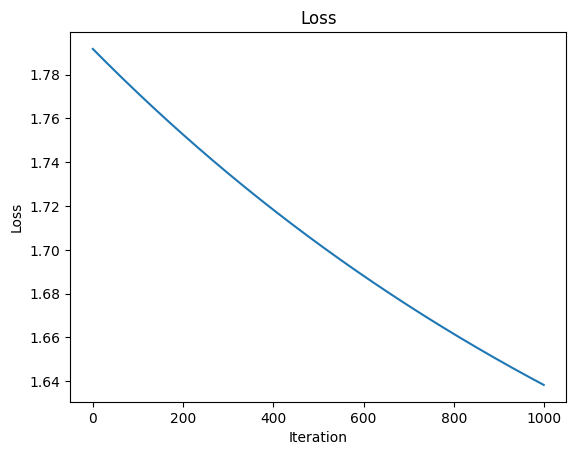

In [18]:
model = MultinomialLogisticRegression()
model.fit(x_train, y_train,x_val,y_val)
model.plot_loss()

In [7]:
# train set
print("Train Accuracy: {0:.4f}".format(model.score(x_train, y_train)))
# validation set
print("Validation Accuracy: {0:.4f}".format(model.score(x_val, y_val)))
# test set
print("Test Accuracy: {0:.4f}".format(model.score(x_test, y_test)))
print("classification report :")
from sklearn.metrics import classification_report
y_pred = model.predict(x_test)
print(classification_report(y_test, y_pred,zero_division=0))

Train Accuracy: 0.5012
Validation Accuracy: 0.5000
Test Accuracy: 0.4934
classification report :
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         6
           2       0.67      0.74      0.70        96
           3       0.59      0.20      0.30        99
           4       0.29      0.85      0.43        26
           5       0.00      0.00      0.00         2

    accuracy                           0.49       229
   macro avg       0.26      0.30      0.24       229
weighted avg       0.57      0.49      0.47       229



##### Hyperparameter Tuning and Evaluation

In [8]:
# hyperparameter tuning using sweeps
sweep_config = {
    'method': 'grid',
    'metric': {
        'name': 'Validation Accuracy',
        'goal': 'maximize'   
    },
    'parameters': {
        'learning_rate': {
            'values': [0.001, 0.01, 0.1]
        },
        'epochs': {
            'values': [1000, 2000, 3000, 4000, 5000]
        },
    }
}

sweep_id = wandb.sweep(sweep_config, project="Q1_1")

def train():
    config_defaults = {
        'learning_rate': 0.01,
        'epochs': 1000,
    }

    wandb.init(config=config_defaults)
    config = wandb.config

    model = MultinomialLogisticRegression(learning_rate=config.learning_rate, max_iter=config.epochs)
    model.fit(x_train, y_train,x_val,y_val)
    print("Validation Accuracy: {0:.4f}".format(model.score(x_val, y_val)))
    wandb.log({"Learning Rate": config.learning_rate, "Epochs": config.epochs, "Validation Accuracy": model.score(x_val, y_val)})

wandb.agent(sweep_id, train)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Create sweep with ID: kb3le9sx
Sweep URL: https://wandb.ai/shravya1051/Q1_1/sweeps/kb3le9sx


wandb: Agent Starting Run: 5vz8zi1c with config:
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: shravya1051. Use `wandb login --relogin` to force relogin


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 2, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 3, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 4, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 5, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 6, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 7, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 8, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 9, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 10, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 11, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 12, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 13, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 14, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 15, Loss: 1.7915, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,1000
Learning Rate,0.001
Validation Accuracy,0.51087


wandb: Agent Starting Run: 86kgecy0 with config:
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 2, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7914
Iteration: 3, Loss: 1.7913, Val Accuracy: 0.5109, Val Loss: 1.7912
Iteration: 4, Loss: 1.7911, Val Accuracy: 0.5109, Val Loss: 1.7910
Iteration: 5, Loss: 1.7909, Val Accuracy: 0.5109, Val Loss: 1.7908
Iteration: 6, Loss: 1.7907, Val Accuracy: 0.5109, Val Loss: 1.7906
Iteration: 7, Loss: 1.7905, Val Accuracy: 0.5109, Val Loss: 1.7904
Iteration: 8, Loss: 1.7903, Val Accuracy: 0.5109, Val Loss: 1.7901
Iteration: 9, Loss: 1.7901, Val Accuracy: 0.5109, Val Loss: 1.7899
Iteration: 10, Loss: 1.7899, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 11, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7895
Iteration: 12, Loss: 1.7895, Val Accuracy: 0.5109, Val Loss: 1.7893
Iteration: 13, Loss: 1.7893, Val Accuracy: 0.5109, Val Loss: 1.7891
Iteration: 14, Loss: 1.7891, Val Accuracy: 0.5109, Val Loss: 1.7889
Iteration: 15, Loss: 1.7889, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,1000
Learning Rate,0.01
Validation Accuracy,0.5


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: nf1qyr54 with config:
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.1
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 2, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7877
Iteration: 3, Loss: 1.7876, Val Accuracy: 0.5109, Val Loss: 1.7858
Iteration: 4, Loss: 1.7856, Val Accuracy: 0.5109, Val Loss: 1.7838
Iteration: 5, Loss: 1.7835, Val Accuracy: 0.5109, Val Loss: 1.7818
Iteration: 6, Loss: 1.7815, Val Accuracy: 0.5109, Val Loss: 1.7799
Iteration: 7, Loss: 1.7795, Val Accuracy: 0.5109, Val Loss: 1.7780
Iteration: 8, Loss: 1.7775, Val Accuracy: 0.5109, Val Loss: 1.7760
Iteration: 9, Loss: 1.7755, Val Accuracy: 0.5109, Val Loss: 1.7741
Iteration: 10, Loss: 1.7735, Val Accuracy: 0.5109, Val Loss: 1.7723
Iteration: 11, Loss: 1.7715, Val Accuracy: 0.5109, Val Loss: 1.7704
Iteration: 12, Loss: 1.7696, Val Accuracy: 0.5109, Val Loss: 1.7685
Iteration: 13, Loss: 1.7676, Val Accuracy: 0.5109, Val Loss: 1.7667
Iteration: 14, Loss: 1.7657, Val Accuracy: 0.5109, Val Loss: 1.7648
Iteration: 15, Loss: 1.7638, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,1000
Learning Rate,0.1
Validation Accuracy,0.53261


wandb: Agent Starting Run: 0ij7xfgp with config:
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 2, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 3, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 4, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 5, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 6, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 7, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 8, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 9, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 10, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 11, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 12, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 13, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 14, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 15, Loss: 1.7915, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,2000
Learning Rate,0.001
Validation Accuracy,0.51087


wandb: Agent Starting Run: fhqsdvu5 with config:
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 2, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7914
Iteration: 3, Loss: 1.7913, Val Accuracy: 0.5109, Val Loss: 1.7912
Iteration: 4, Loss: 1.7911, Val Accuracy: 0.5109, Val Loss: 1.7910
Iteration: 5, Loss: 1.7909, Val Accuracy: 0.5109, Val Loss: 1.7908
Iteration: 6, Loss: 1.7907, Val Accuracy: 0.5109, Val Loss: 1.7906
Iteration: 7, Loss: 1.7905, Val Accuracy: 0.5109, Val Loss: 1.7904
Iteration: 8, Loss: 1.7903, Val Accuracy: 0.5109, Val Loss: 1.7901
Iteration: 9, Loss: 1.7901, Val Accuracy: 0.5109, Val Loss: 1.7899
Iteration: 10, Loss: 1.7899, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 11, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7895
Iteration: 12, Loss: 1.7895, Val Accuracy: 0.5109, Val Loss: 1.7893
Iteration: 13, Loss: 1.7893, Val Accuracy: 0.5109, Val Loss: 1.7891
Iteration: 14, Loss: 1.7891, Val Accuracy: 0.5109, Val Loss: 1.7889
Iteration: 15, Loss: 1.7889, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,2000
Learning Rate,0.01
Validation Accuracy,0.51087


wandb: Agent Starting Run: wpmxpx45 with config:
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.1
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 2, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7877
Iteration: 3, Loss: 1.7876, Val Accuracy: 0.5109, Val Loss: 1.7858
Iteration: 4, Loss: 1.7856, Val Accuracy: 0.5109, Val Loss: 1.7838
Iteration: 5, Loss: 1.7835, Val Accuracy: 0.5109, Val Loss: 1.7818
Iteration: 6, Loss: 1.7815, Val Accuracy: 0.5109, Val Loss: 1.7799
Iteration: 7, Loss: 1.7795, Val Accuracy: 0.5109, Val Loss: 1.7780
Iteration: 8, Loss: 1.7775, Val Accuracy: 0.5109, Val Loss: 1.7760
Iteration: 9, Loss: 1.7755, Val Accuracy: 0.5109, Val Loss: 1.7741
Iteration: 10, Loss: 1.7735, Val Accuracy: 0.5109, Val Loss: 1.7723
Iteration: 11, Loss: 1.7715, Val Accuracy: 0.5109, Val Loss: 1.7704
Iteration: 12, Loss: 1.7696, Val Accuracy: 0.5109, Val Loss: 1.7685
Iteration: 13, Loss: 1.7676, Val Accuracy: 0.5109, Val Loss: 1.7667
Iteration: 14, Loss: 1.7657, Val Accuracy: 0.5109, Val Loss: 1.7648
Iteration: 15, Loss: 1.7638, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,2000
Learning Rate,0.1
Validation Accuracy,0.55435


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: b2qzr7e1 with config:
wandb: 	epochs: 3000
wandb: 	learning_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 2, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 3, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 4, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 5, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 6, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 7, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 8, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 9, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 10, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 11, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 12, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 13, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 14, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 15, Loss: 1.7915, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,3000
Learning Rate,0.001
Validation Accuracy,0.51087


wandb: Agent Starting Run: bnuk013k with config:
wandb: 	epochs: 3000
wandb: 	learning_rate: 0.01
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 2, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7914
Iteration: 3, Loss: 1.7913, Val Accuracy: 0.5109, Val Loss: 1.7912
Iteration: 4, Loss: 1.7911, Val Accuracy: 0.5109, Val Loss: 1.7910
Iteration: 5, Loss: 1.7909, Val Accuracy: 0.5109, Val Loss: 1.7908
Iteration: 6, Loss: 1.7907, Val Accuracy: 0.5109, Val Loss: 1.7906
Iteration: 7, Loss: 1.7905, Val Accuracy: 0.5109, Val Loss: 1.7904
Iteration: 8, Loss: 1.7903, Val Accuracy: 0.5109, Val Loss: 1.7901
Iteration: 9, Loss: 1.7901, Val Accuracy: 0.5109, Val Loss: 1.7899
Iteration: 10, Loss: 1.7899, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 11, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7895
Iteration: 12, Loss: 1.7895, Val Accuracy: 0.5109, Val Loss: 1.7893
Iteration: 13, Loss: 1.7893, Val Accuracy: 0.5109, Val Loss: 1.7891
Iteration: 14, Loss: 1.7891, Val Accuracy: 0.5109, Val Loss: 1.7889
Iteration: 15, Loss: 1.7889, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,3000
Learning Rate,0.01
Validation Accuracy,0.48913


wandb: Agent Starting Run: 25pj1tql with config:
wandb: 	epochs: 3000
wandb: 	learning_rate: 0.1
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 2, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7877
Iteration: 3, Loss: 1.7876, Val Accuracy: 0.5109, Val Loss: 1.7858
Iteration: 4, Loss: 1.7856, Val Accuracy: 0.5109, Val Loss: 1.7838
Iteration: 5, Loss: 1.7835, Val Accuracy: 0.5109, Val Loss: 1.7818
Iteration: 6, Loss: 1.7815, Val Accuracy: 0.5109, Val Loss: 1.7799
Iteration: 7, Loss: 1.7795, Val Accuracy: 0.5109, Val Loss: 1.7780
Iteration: 8, Loss: 1.7775, Val Accuracy: 0.5109, Val Loss: 1.7760
Iteration: 9, Loss: 1.7755, Val Accuracy: 0.5109, Val Loss: 1.7741
Iteration: 10, Loss: 1.7735, Val Accuracy: 0.5109, Val Loss: 1.7723
Iteration: 11, Loss: 1.7715, Val Accuracy: 0.5109, Val Loss: 1.7704
Iteration: 12, Loss: 1.7696, Val Accuracy: 0.5109, Val Loss: 1.7685
Iteration: 13, Loss: 1.7676, Val Accuracy: 0.5109, Val Loss: 1.7667
Iteration: 14, Loss: 1.7657, Val Accuracy: 0.5109, Val Loss: 1.7648
Iteration: 15, Loss: 1.7638, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,3000
Learning Rate,0.1
Validation Accuracy,0.56522


wandb: Agent Starting Run: g5ks3tf0 with config:
wandb: 	epochs: 4000
wandb: 	learning_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 2, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 3, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 4, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 5, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 6, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 7, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 8, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 9, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 10, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 11, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 12, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 13, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 14, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 15, Loss: 1.7915, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,4000
Learning Rate,0.001
Validation Accuracy,0.51087


wandb: Agent Starting Run: zz6b9mmu with config:
wandb: 	epochs: 4000
wandb: 	learning_rate: 0.01
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 2, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7914
Iteration: 3, Loss: 1.7913, Val Accuracy: 0.5109, Val Loss: 1.7912
Iteration: 4, Loss: 1.7911, Val Accuracy: 0.5109, Val Loss: 1.7910
Iteration: 5, Loss: 1.7909, Val Accuracy: 0.5109, Val Loss: 1.7908
Iteration: 6, Loss: 1.7907, Val Accuracy: 0.5109, Val Loss: 1.7906
Iteration: 7, Loss: 1.7905, Val Accuracy: 0.5109, Val Loss: 1.7904
Iteration: 8, Loss: 1.7903, Val Accuracy: 0.5109, Val Loss: 1.7901
Iteration: 9, Loss: 1.7901, Val Accuracy: 0.5109, Val Loss: 1.7899
Iteration: 10, Loss: 1.7899, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 11, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7895
Iteration: 12, Loss: 1.7895, Val Accuracy: 0.5109, Val Loss: 1.7893
Iteration: 13, Loss: 1.7893, Val Accuracy: 0.5109, Val Loss: 1.7891
Iteration: 14, Loss: 1.7891, Val Accuracy: 0.5109, Val Loss: 1.7889
Iteration: 15, Loss: 1.7889, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,4000
Learning Rate,0.01
Validation Accuracy,0.48913


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: al5a549p with config:
wandb: 	epochs: 4000
wandb: 	learning_rate: 0.1
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 2, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7877
Iteration: 3, Loss: 1.7876, Val Accuracy: 0.5109, Val Loss: 1.7858
Iteration: 4, Loss: 1.7856, Val Accuracy: 0.5109, Val Loss: 1.7838
Iteration: 5, Loss: 1.7835, Val Accuracy: 0.5109, Val Loss: 1.7818
Iteration: 6, Loss: 1.7815, Val Accuracy: 0.5109, Val Loss: 1.7799
Iteration: 7, Loss: 1.7795, Val Accuracy: 0.5109, Val Loss: 1.7780
Iteration: 8, Loss: 1.7775, Val Accuracy: 0.5109, Val Loss: 1.7760
Iteration: 9, Loss: 1.7755, Val Accuracy: 0.5109, Val Loss: 1.7741
Iteration: 10, Loss: 1.7735, Val Accuracy: 0.5109, Val Loss: 1.7723
Iteration: 11, Loss: 1.7715, Val Accuracy: 0.5109, Val Loss: 1.7704
Iteration: 12, Loss: 1.7696, Val Accuracy: 0.5109, Val Loss: 1.7685
Iteration: 13, Loss: 1.7676, Val Accuracy: 0.5109, Val Loss: 1.7667
Iteration: 14, Loss: 1.7657, Val Accuracy: 0.5109, Val Loss: 1.7648
Iteration: 15, Loss: 1.7638, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,4000
Learning Rate,0.1
Validation Accuracy,0.56522


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: u0h21v7x with config:
wandb: 	epochs: 5000
wandb: 	learning_rate: 0.001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 2, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 3, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 4, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 5, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7917
Iteration: 6, Loss: 1.7917, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 7, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 8, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 9, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 10, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 11, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 12, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 13, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 14, Loss: 1.7915, Val Accuracy: 0.5109, Val Loss: 1.7915
Iteration: 15, Loss: 1.7915, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,5000
Learning Rate,0.001
Validation Accuracy,0.51087


wandb: Agent Starting Run: e1g79kn5 with config:
wandb: 	epochs: 5000
wandb: 	learning_rate: 0.01
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7916
Iteration: 2, Loss: 1.7916, Val Accuracy: 0.5109, Val Loss: 1.7914
Iteration: 3, Loss: 1.7913, Val Accuracy: 0.5109, Val Loss: 1.7912
Iteration: 4, Loss: 1.7911, Val Accuracy: 0.5109, Val Loss: 1.7910
Iteration: 5, Loss: 1.7909, Val Accuracy: 0.5109, Val Loss: 1.7908
Iteration: 6, Loss: 1.7907, Val Accuracy: 0.5109, Val Loss: 1.7906
Iteration: 7, Loss: 1.7905, Val Accuracy: 0.5109, Val Loss: 1.7904
Iteration: 8, Loss: 1.7903, Val Accuracy: 0.5109, Val Loss: 1.7901
Iteration: 9, Loss: 1.7901, Val Accuracy: 0.5109, Val Loss: 1.7899
Iteration: 10, Loss: 1.7899, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 11, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7895
Iteration: 12, Loss: 1.7895, Val Accuracy: 0.5109, Val Loss: 1.7893
Iteration: 13, Loss: 1.7893, Val Accuracy: 0.5109, Val Loss: 1.7891
Iteration: 14, Loss: 1.7891, Val Accuracy: 0.5109, Val Loss: 1.7889
Iteration: 15, Loss: 1.7889, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,5000
Learning Rate,0.01
Validation Accuracy,0.48913


wandb: Agent Starting Run: aj4g6s0u with config:
wandb: 	epochs: 5000
wandb: 	learning_rate: 0.1
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 2, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7877
Iteration: 3, Loss: 1.7876, Val Accuracy: 0.5109, Val Loss: 1.7858
Iteration: 4, Loss: 1.7856, Val Accuracy: 0.5109, Val Loss: 1.7838
Iteration: 5, Loss: 1.7835, Val Accuracy: 0.5109, Val Loss: 1.7818
Iteration: 6, Loss: 1.7815, Val Accuracy: 0.5109, Val Loss: 1.7799
Iteration: 7, Loss: 1.7795, Val Accuracy: 0.5109, Val Loss: 1.7780
Iteration: 8, Loss: 1.7775, Val Accuracy: 0.5109, Val Loss: 1.7760
Iteration: 9, Loss: 1.7755, Val Accuracy: 0.5109, Val Loss: 1.7741
Iteration: 10, Loss: 1.7735, Val Accuracy: 0.5109, Val Loss: 1.7723
Iteration: 11, Loss: 1.7715, Val Accuracy: 0.5109, Val Loss: 1.7704
Iteration: 12, Loss: 1.7696, Val Accuracy: 0.5109, Val Loss: 1.7685
Iteration: 13, Loss: 1.7676, Val Accuracy: 0.5109, Val Loss: 1.7667
Iteration: 14, Loss: 1.7657, Val Accuracy: 0.5109, Val Loss: 1.7648
Iteration: 15, Loss: 1.7638, Val Accuracy: 0.5109, Val Lo

Epochs,▁
Learning Rate,▁
Validation Accuracy,▁
Epochs,5000
Learning Rate,0.1
Validation Accuracy,0.55435


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [23]:
# Use your validation set and W&B logging to fine-tune the hyperparameters (learning rate , epochs) for optimal results
wandb.init(project="Q1",entity="shravya1051")

learning_rates = [0.1,0.01, 0.001, 0.0001]
epochs = [1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000,9000,10000]

for lr in learning_rates:
    for epoch in epochs:
        model = MultinomialLogisticRegression(learning_rate=lr, max_iter=epoch)
        model.fit(x_train, y_train,x_val,y_val)
        print("Validation Accuracy: {0:.4f}".format(model.score(x_val, y_val)))
        wandb.log({"Learning Rate": lr, "Epochs": epoch, "Validation Accuracy": model.score(x_val, y_val)})

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: shravya1051. Use `wandb login --relogin` to force relogin


Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7902
Iteration: 2, Loss: 1.7902, Val Accuracy: 0.5109, Val Loss: 1.7886
Iteration: 3, Loss: 1.7886, Val Accuracy: 0.5109, Val Loss: 1.7870
Iteration: 4, Loss: 1.7871, Val Accuracy: 0.5109, Val Loss: 1.7854
Iteration: 5, Loss: 1.7855, Val Accuracy: 0.5109, Val Loss: 1.7839
Iteration: 6, Loss: 1.7840, Val Accuracy: 0.5109, Val Loss: 1.7823
Iteration: 7, Loss: 1.7825, Val Accuracy: 0.5109, Val Loss: 1.7808
Iteration: 8, Loss: 1.7809, Val Accuracy: 0.5109, Val Loss: 1.7792
Iteration: 9, Loss: 1.7794, Val Accuracy: 0.5109, Val Loss: 1.7777
Iteration: 10, Loss: 1.7779, Val Accuracy: 0.5109, Val Loss: 1.7762
Iteration: 11, Loss: 1.7764, Val Accuracy: 0.5109, Val Loss: 1.7747
Iteration: 12, Loss: 1.7749, Val Accuracy: 0.5109, Val Loss: 1.7732
Iteration: 13, Loss: 1.7735, Val Accuracy: 0.5109, Val Loss: 1.7717
Iteration: 14, Loss: 1.7720, Val Accuracy: 0.5109, Val Loss: 1.7703
Iteration: 15, Loss: 1.7705, Val Accuracy: 0.5109, Val Lo

In [9]:
# Retain the best model and report the accuracy on the test set
model = MultinomialLogisticRegression(learning_rate=0.1, max_iter=3000)
model.fit(x_train, y_train,x_val,y_val)

Iteration: 1, Loss: 1.7918, Val Accuracy: 0.5109, Val Loss: 1.7897
Iteration: 2, Loss: 1.7897, Val Accuracy: 0.5109, Val Loss: 1.7877
Iteration: 3, Loss: 1.7876, Val Accuracy: 0.5109, Val Loss: 1.7858
Iteration: 4, Loss: 1.7856, Val Accuracy: 0.5109, Val Loss: 1.7838
Iteration: 5, Loss: 1.7835, Val Accuracy: 0.5109, Val Loss: 1.7818
Iteration: 6, Loss: 1.7815, Val Accuracy: 0.5109, Val Loss: 1.7799
Iteration: 7, Loss: 1.7795, Val Accuracy: 0.5109, Val Loss: 1.7780
Iteration: 8, Loss: 1.7775, Val Accuracy: 0.5109, Val Loss: 1.7760
Iteration: 9, Loss: 1.7755, Val Accuracy: 0.5109, Val Loss: 1.7741
Iteration: 10, Loss: 1.7735, Val Accuracy: 0.5109, Val Loss: 1.7723
Iteration: 11, Loss: 1.7715, Val Accuracy: 0.5109, Val Loss: 1.7704
Iteration: 12, Loss: 1.7696, Val Accuracy: 0.5109, Val Loss: 1.7685
Iteration: 13, Loss: 1.7676, Val Accuracy: 0.5109, Val Loss: 1.7667
Iteration: 14, Loss: 1.7657, Val Accuracy: 0.5109, Val Loss: 1.7648
Iteration: 15, Loss: 1.7638, Val Accuracy: 0.5109, Val Lo

In [10]:
print("Test Accuracy: {0:.4f}".format(model.score(x_test, y_test)))
print("classification report :")
y_pred = model.predict(x_test)
print(classification_report(y_test, y_pred,zero_division=0))

Test Accuracy: 0.5633
classification report :
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         6
           2       0.73      0.72      0.73        96
           3       0.63      0.41      0.50        99
           4       0.32      0.73      0.45        26
           5       0.00      0.00      0.00         2

    accuracy                           0.56       229
   macro avg       0.28      0.31      0.28       229
weighted avg       0.62      0.56      0.57       229



### PART 2

##### MULTI LAYER PERCEPTRON MODEL

In [4]:
class MLPClassifier:
    def __init__(self, learning_rate=0.01, epochs=1000, activation='sigmoid', neurons = 10, optimizer='sgd', mini_batch_size=None, hidden_layers=1, verbose = True):
        self.learning_rate = learning_rate
        self.epochs = epochs
        self.activation = activation
        self.neurons = neurons
        self.loss = []
        self.val_loss = []
        self.weights = []
        self.bias = []
        self.optimizer = optimizer
        self.mini_batch_size = mini_batch_size
        self.hidden_layers = hidden_layers
        self.verbose = verbose

    # activation functions

    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))
    
    def tanh(self, x):
        return np.tanh(x)
    
    def relu(self, x):
        return np.maximum(0, x)
    
    def gradient_sigmoid(self, x):
        return x * (1 - x)
    
    def gradient_tanh(self, x):
        return 1 - (x ** 2)
    
    def gradient_relu(self, x):
        return 1 * (x > 0)
    
    # optimizer functions

    def sgd(self, x, y):
        for i in range(len(x)):
            x_reshaped = x[i].reshape(1, -1)
            z = self.forward(x_reshaped)
            grad_w, grad_b = self.backward(x_reshaped, y[i], z)
            self.update_weights(x_reshaped, grad_w)
            self.update_bias(x_reshaped,grad_b)
    
    def bgd(self, x, y):
        z = self.forward(x)
        grad_w, grad_b = self.backward(x, y, z)
        self.update_weights(x, grad_w)
        self.update_bias(x,grad_b)

    def mbgd(self, x, y):
        for i in range(0, len(x), self.mini_batch_size):
            z = self.forward(x[i:i+self.mini_batch_size])
            grad_w, grad_b = self.backward(x[i:i+self.mini_batch_size], y[i:i+self.mini_batch_size], z)
            self.update_weights(x[i:i+self.mini_batch_size], grad_w)
            self.update_bias(x[i:i+self.mini_batch_size], grad_b)

    # forward and backward pass
    
    def forward(self, x):
        z = []
        for i in range(len(self.weights)):
            if i == 0:
                z.append(np.dot(x, self.weights[i]) + self.bias[i])
            else:
                z.append(np.dot(z[i-1], self.weights[i]) + self.bias[i])
            if i == len(self.weights) - 1:
                break
            if self.activation == 'sigmoid':
                z[i] = self.sigmoid(z[i])
            elif self.activation == 'tanh':
                z[i] = self.tanh(z[i])
            elif self.activation == 'relu':
                z[i] = self.relu(z[i])
        return z
    
    def backward(self, x, y, z):
        grad_w = []
        grad_b = []
        for i in reversed(range(len(self.weights))):
            if i == len(self.weights) - 1:
                error = z[i] - y
                grad = error
                grad_w.append(np.dot(z[i-1].T, error))
                grad_b.append(np.sum(error, axis=0, keepdims=True))
            elif i == 0:
                error = np.dot(grad, self.weights[i+1].T)
                if self.activation == 'sigmoid':
                    grad = error * self.gradient_sigmoid(z[i])
                elif self.activation == 'tanh':
                    grad = error * self.gradient_tanh(z[i])
                elif self.activation == 'relu':
                    grad = error * self.gradient_relu(z[i])
                grad_w.append(np.dot(x.T, grad))
                grad_b.append(np.sum(grad, axis=0, keepdims=True))
            else:
                error = np.dot(grad, self.weights[i+1].T)
                if self.activation == 'sigmoid':
                    grad = error * self.gradient_sigmoid(z[i])
                elif self.activation == 'tanh':
                    grad = error * self.gradient_tanh(z[i])
                elif self.activation == 'relu':
                    grad = error * self.gradient_relu(z[i])
                grad_w.append(np.dot(z[i-1].T, grad))
                grad_b.append(np.sum(grad, axis=0, keepdims=True))
        grad_w.reverse()
        grad_b.reverse()
        return grad_w, grad_b
    
    # update weights and bias

    def update_weights(self, x, grad_w):
        for i in range(len(self.weights)):
            self.weights[i] -= self.learning_rate * grad_w[i]/len(x)
    
    def update_bias(self, x, grad_b):
        for i in range(len(self.bias)):
            self.bias[i] -= self.learning_rate * grad_b[i]/len(x)

    # fit and predict

    def fit(self, x, y, x_val, y_val):
        n_features = x.shape[1]
        n_classes = len(np.unique(labels))
        # multiple hidden layers
        for i in range(self.hidden_layers):
            if i == 0:
                self.weights.append(np.random.randn(n_features, self.neurons))
                self.bias.append(np.zeros((1, self.neurons)))
            else:
                self.weights.append(np.random.randn(self.neurons, self.neurons))
                self.bias.append(np.zeros((1, self.neurons)))
        self.weights.append(np.random.randn(self.neurons, n_classes))
        self.bias.append(np.zeros((1, n_classes)))
        for i in range(self.epochs):
            if self.optimizer == 'sgd':
                self.sgd(x, y)
            elif self.optimizer == 'bgd':
                self.bgd(x, y)
            elif self.optimizer == 'mbgd':
                self.mbgd(x, y)
            else:
                raise ValueError("Optimizer must be 'sgd', 'bgd', or 'mbgd'")
            loss = self.cross_entropy_loss(x, y)
            val_loss = self.cross_entropy_loss(x_val, y_val)
            self.loss.append(loss)
            self.val_loss.append(val_loss)
            val_accuracy = self.score(x_val, y_val)
            accuracy = self.score(x, y)
            if self.verbose:
                print("Iteration: {0}, Loss: {1:.4f}, Accuracy: {2:.4f}, Val Loss: {3:.4f}, Val Accuracy: {4:.4f}".format(i+1, loss, accuracy, val_loss, val_accuracy))
        return self

    def predict(self, x):
        probs = self.softmax(x)
        return np.argmax(probs, axis=1)

    def one_hot_encode(self, y):
        y = np.eye(len(np.unique(labels)))[y]
        return y

    def softmax(self, x):
        z = self.forward(x)
        probs = np.exp(z[-1]) / np.sum(np.exp(z[-1]), axis=1, keepdims=True)
        return probs
    
    def cross_entropy_loss(self, x, y):
        probs = self.softmax(x)
        loss = -np.sum(y * np.log(probs)) / len(x)
        return loss
    
    def score(self, x, y):
        y_pred = self.predict(x)
        accuracy = np.sum(y_pred == np.argmax(y, axis=1)) / len(x)
        return accuracy
    
    def plot_loss(self):
        plt.plot(self.loss, label='loss')
        plt.plot(self.val_loss, label='val_loss')
        plt.title("Loss")
        plt.xlabel("Iteration")
        plt.ylabel("Loss")
        plt.legend()
        plt.show()

Iteration: 1, Loss: 1.6220, Accuracy: 0.3808, Val Loss: 1.6425, Val Accuracy: 0.3696
Iteration: 2, Loss: 1.6104, Accuracy: 0.4136, Val Loss: 1.6331, Val Accuracy: 0.3587
Iteration: 3, Loss: 1.6067, Accuracy: 0.4367, Val Loss: 1.6293, Val Accuracy: 0.3804
Iteration: 4, Loss: 1.6041, Accuracy: 0.4611, Val Loss: 1.6267, Val Accuracy: 0.4239
Iteration: 5, Loss: 1.6023, Accuracy: 0.4866, Val Loss: 1.6248, Val Accuracy: 0.4239
Iteration: 6, Loss: 1.6010, Accuracy: 0.4964, Val Loss: 1.6235, Val Accuracy: 0.4348
Iteration: 7, Loss: 1.6000, Accuracy: 0.4988, Val Loss: 1.6224, Val Accuracy: 0.4348
Iteration: 8, Loss: 1.5992, Accuracy: 0.5000, Val Loss: 1.6215, Val Accuracy: 0.4348
Iteration: 9, Loss: 1.5986, Accuracy: 0.5024, Val Loss: 1.6208, Val Accuracy: 0.4239
Iteration: 10, Loss: 1.5980, Accuracy: 0.5036, Val Loss: 1.6201, Val Accuracy: 0.4239
Iteration: 11, Loss: 1.5975, Accuracy: 0.5024, Val Loss: 1.6195, Val Accuracy: 0.4130
Iteration: 12, Loss: 1.5971, Accuracy: 0.5024, Val Loss: 1.6190

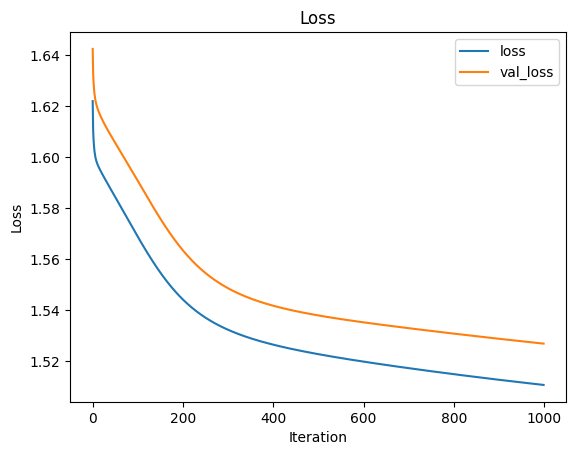

In [20]:
# train
model = MLPClassifier(learning_rate=0.01, epochs=1000, activation='sigmoid', neurons = 10, optimizer='mbgd', mini_batch_size=10, hidden_layers=3)
model.fit(x_train, model.one_hot_encode(y_train), x_val, model.one_hot_encode(y_val))
model.plot_loss()


In [11]:
# Hyperparameter tuning using sweeps
sweep_config = {
    'method': 'grid',
    'metric': {
        'name': 'Validation Accuracy',
        'goal': 'maximize'   
    },
    'parameters': {
        'activation': {
            'values': ['sigmoid', 'tanh', 'relu']
        },
        'optimizer': {
            'values': ['sgd', 'bgd', 'mbgd']
        },
    }
}

sweep_id = wandb.sweep(sweep_config, project="Q1_2")

def train():
    config_defaults = {
        'activation': 'sigmoid',
        'optimizer': 'sgd',
    }

    wandb.init(config=config_defaults)
    config = wandb.config

    model = MLPClassifier(learning_rate=0.01, epochs=1000, activation=config.activation, neurons = 10, optimizer=config.optimizer, mini_batch_size=10, hidden_layers=1)
    model.fit(x_train, model.one_hot_encode(y_train), x_val, model.one_hot_encode(y_val))
    print("Validation Accuracy: {0:.4f}".format(model.score(x_val, model.one_hot_encode(y_val))))
    wandb.log({"Activation": config.activation, "Optimizer": config.optimizer, "Validation Accuracy": model.score(x_val, model.one_hot_encode(y_val))})

wandb.agent(sweep_id, train)

Create sweep with ID: pjangfzf
Sweep URL: https://wandb.ai/shravya1051/Q1_2/sweeps/pjangfzf


wandb: Agent Starting Run: 2s4kp49p with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.8717, Accuracy: 0.3552, Val Loss: 1.8986, Val Accuracy: 0.3478
Iteration: 2, Loss: 1.8423, Accuracy: 0.4440, Val Loss: 1.8726, Val Accuracy: 0.3804
Iteration: 3, Loss: 1.8322, Accuracy: 0.4915, Val Loss: 1.8606, Val Accuracy: 0.4348
Iteration: 4, Loss: 1.8266, Accuracy: 0.5195, Val Loss: 1.8529, Val Accuracy: 0.4891
Iteration: 5, Loss: 1.8229, Accuracy: 0.5438, Val Loss: 1.8473, Val Accuracy: 0.5109
Iteration: 6, Loss: 1.8200, Accuracy: 0.5523, Val Loss: 1.8431, Val Accuracy: 0.5109
Iteration: 7, Loss: 1.8177, Accuracy: 0.5608, Val Loss: 1.8398, Val Accuracy: 0.5217
Iteration: 8, Loss: 1.8158, Accuracy: 0.5657, Val Loss: 1.8371, Val Accuracy: 0.5217
Iteration: 9, Loss: 1.8141, Accuracy: 0.5681, Val Loss: 1.8349, Val Accuracy: 0.5326
Iteration: 10, Loss: 1.8126, Accuracy: 0.5669, Val Loss: 1.8330, Val Accuracy: 0.5326
Iteration: 11, Loss: 1.8112, Accuracy: 0.5669, Val Loss: 1.8314, Val Accuracy: 0.5326
Iteration: 12, Loss: 1.8099, Accuracy: 0.5742, Val Loss: 1.8300

Validation Accuracy,▁
Activation,sigmoid
Optimizer,sgd
Validation Accuracy,0.57609


wandb: Agent Starting Run: oe83jchp with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 2.6598, Accuracy: 0.1959, Val Loss: 2.8597, Val Accuracy: 0.1630
Iteration: 2, Loss: 2.6224, Accuracy: 0.1946, Val Loss: 2.8168, Val Accuracy: 0.1630
Iteration: 3, Loss: 2.5870, Accuracy: 0.1983, Val Loss: 2.7761, Val Accuracy: 0.1522
Iteration: 4, Loss: 2.5534, Accuracy: 0.1971, Val Loss: 2.7375, Val Accuracy: 0.1413
Iteration: 5, Loss: 2.5215, Accuracy: 0.1995, Val Loss: 2.7008, Val Accuracy: 0.1413
Iteration: 6, Loss: 2.4913, Accuracy: 0.1995, Val Loss: 2.6659, Val Accuracy: 0.1413
Iteration: 7, Loss: 2.4626, Accuracy: 0.2019, Val Loss: 2.6328, Val Accuracy: 0.1522
Iteration: 8, Loss: 2.4354, Accuracy: 0.2044, Val Loss: 2.6014, Val Accuracy: 0.1522
Iteration: 9, Loss: 2.4096, Accuracy: 0.2044, Val Loss: 2.5715, Val Accuracy: 0.1522
Iteration: 10, Loss: 2.3851, Accuracy: 0.2056, Val Loss: 2.5430, Val Accuracy: 0.1522
Iteration: 11, Loss: 2.3619, Accuracy: 0.2068, Val Loss: 2.5160, Val Accuracy: 0.1522
Iteration: 12, Loss: 2.3398, Accuracy: 0.2080, Val Loss: 2.4903

Validation Accuracy,▁
Activation,sigmoid
Optimizer,bgd
Validation Accuracy,0.45652


wandb: Agent Starting Run: qwrfezmw with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 2.0027, Accuracy: 0.2397, Val Loss: 1.9690, Val Accuracy: 0.2391
Iteration: 2, Loss: 1.9626, Accuracy: 0.2749, Val Loss: 1.9378, Val Accuracy: 0.2391
Iteration: 3, Loss: 1.9332, Accuracy: 0.2993, Val Loss: 1.9116, Val Accuracy: 0.2717
Iteration: 4, Loss: 1.9107, Accuracy: 0.3260, Val Loss: 1.8913, Val Accuracy: 0.2826
Iteration: 5, Loss: 1.8929, Accuracy: 0.3479, Val Loss: 1.8753, Val Accuracy: 0.3261
Iteration: 6, Loss: 1.8787, Accuracy: 0.3735, Val Loss: 1.8625, Val Accuracy: 0.3261
Iteration: 7, Loss: 1.8670, Accuracy: 0.3820, Val Loss: 1.8520, Val Accuracy: 0.3370
Iteration: 8, Loss: 1.8573, Accuracy: 0.3990, Val Loss: 1.8433, Val Accuracy: 0.3913
Iteration: 9, Loss: 1.8491, Accuracy: 0.4185, Val Loss: 1.8360, Val Accuracy: 0.3913
Iteration: 10, Loss: 1.8422, Accuracy: 0.4392, Val Loss: 1.8298, Val Accuracy: 0.4130
Iteration: 11, Loss: 1.8362, Accuracy: 0.4489, Val Loss: 1.8246, Val Accuracy: 0.4130
Iteration: 12, Loss: 1.8311, Accuracy: 0.4562, Val Loss: 1.8201

Validation Accuracy,▁
Activation,sigmoid
Optimizer,mbgd
Validation Accuracy,0.6087


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: l344a3at with config:
wandb: 	activation: tanh
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.8134, Accuracy: 0.4708, Val Loss: 1.8371, Val Accuracy: 0.3804
Iteration: 2, Loss: 1.7979, Accuracy: 0.5341, Val Loss: 1.8207, Val Accuracy: 0.4457
Iteration: 3, Loss: 1.7913, Accuracy: 0.5487, Val Loss: 1.8156, Val Accuracy: 0.4565
Iteration: 4, Loss: 1.7878, Accuracy: 0.5596, Val Loss: 1.8130, Val Accuracy: 0.4565
Iteration: 5, Loss: 1.7857, Accuracy: 0.5742, Val Loss: 1.8113, Val Accuracy: 0.4783
Iteration: 6, Loss: 1.7843, Accuracy: 0.5803, Val Loss: 1.8099, Val Accuracy: 0.5109
Iteration: 7, Loss: 1.7833, Accuracy: 0.5864, Val Loss: 1.8088, Val Accuracy: 0.5217
Iteration: 8, Loss: 1.7826, Accuracy: 0.5912, Val Loss: 1.8078, Val Accuracy: 0.5326
Iteration: 9, Loss: 1.7819, Accuracy: 0.5937, Val Loss: 1.8070, Val Accuracy: 0.5326
Iteration: 10, Loss: 1.7814, Accuracy: 0.5925, Val Loss: 1.8063, Val Accuracy: 0.5326
Iteration: 11, Loss: 1.7809, Accuracy: 0.5937, Val Loss: 1.8057, Val Accuracy: 0.5435
Iteration: 12, Loss: 1.7805, Accuracy: 0.5888, Val Loss: 1.8052

Validation Accuracy,▁
Activation,tanh
Optimizer,sgd
Validation Accuracy,0.55435


wandb: Agent Starting Run: egkunup4 with config:
wandb: 	activation: tanh
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 3.0257, Accuracy: 0.1691, Val Loss: 3.2148, Val Accuracy: 0.2065
Iteration: 2, Loss: 2.9995, Accuracy: 0.1691, Val Loss: 3.1885, Val Accuracy: 0.2065
Iteration: 3, Loss: 2.9742, Accuracy: 0.1703, Val Loss: 3.1631, Val Accuracy: 0.2065
Iteration: 4, Loss: 2.9498, Accuracy: 0.1740, Val Loss: 3.1386, Val Accuracy: 0.2174
Iteration: 5, Loss: 2.9261, Accuracy: 0.1752, Val Loss: 3.1149, Val Accuracy: 0.2174
Iteration: 6, Loss: 2.9032, Accuracy: 0.1740, Val Loss: 3.0919, Val Accuracy: 0.2174
Iteration: 7, Loss: 2.8810, Accuracy: 0.1727, Val Loss: 3.0697, Val Accuracy: 0.2174
Iteration: 8, Loss: 2.8596, Accuracy: 0.1788, Val Loss: 3.0481, Val Accuracy: 0.2174
Iteration: 9, Loss: 2.8388, Accuracy: 0.1800, Val Loss: 3.0272, Val Accuracy: 0.2174
Iteration: 10, Loss: 2.8186, Accuracy: 0.1837, Val Loss: 3.0070, Val Accuracy: 0.2174
Iteration: 11, Loss: 2.7990, Accuracy: 0.1849, Val Loss: 2.9873, Val Accuracy: 0.2174
Iteration: 12, Loss: 2.7800, Accuracy: 0.1886, Val Loss: 2.9682

Validation Accuracy,▁
Activation,tanh
Optimizer,bgd
Validation Accuracy,0.42391


wandb: Agent Starting Run: x5ulv9me with config:
wandb: 	activation: tanh
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 2.0796, Accuracy: 0.1946, Val Loss: 2.1474, Val Accuracy: 0.1957
Iteration: 2, Loss: 1.9154, Accuracy: 0.2920, Val Loss: 1.9583, Val Accuracy: 0.2391
Iteration: 3, Loss: 1.8556, Accuracy: 0.3491, Val Loss: 1.8890, Val Accuracy: 0.2826
Iteration: 4, Loss: 1.8251, Accuracy: 0.4246, Val Loss: 1.8542, Val Accuracy: 0.3696
Iteration: 5, Loss: 1.8070, Accuracy: 0.4562, Val Loss: 1.8335, Val Accuracy: 0.4239
Iteration: 6, Loss: 1.7954, Accuracy: 0.4951, Val Loss: 1.8200, Val Accuracy: 0.4348
Iteration: 7, Loss: 1.7874, Accuracy: 0.5170, Val Loss: 1.8107, Val Accuracy: 0.4674
Iteration: 8, Loss: 1.7816, Accuracy: 0.5328, Val Loss: 1.8040, Val Accuracy: 0.5000
Iteration: 9, Loss: 1.7774, Accuracy: 0.5426, Val Loss: 1.7990, Val Accuracy: 0.4891
Iteration: 10, Loss: 1.7742, Accuracy: 0.5535, Val Loss: 1.7953, Val Accuracy: 0.5000
Iteration: 11, Loss: 1.7717, Accuracy: 0.5547, Val Loss: 1.7924, Val Accuracy: 0.5000
Iteration: 12, Loss: 1.7697, Accuracy: 0.5608, Val Loss: 1.7903

Validation Accuracy,▁
Activation,tanh
Optimizer,mbgd
Validation Accuracy,0.56522


wandb: Agent Starting Run: bfa6pwww with config:
wandb: 	activation: relu
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 1.8567, Accuracy: 0.5170, Val Loss: 1.8653, Val Accuracy: 0.4239
Iteration: 2, Loss: 1.8312, Accuracy: 0.5182, Val Loss: 1.8418, Val Accuracy: 0.4348
Iteration: 3, Loss: 1.8197, Accuracy: 0.5207, Val Loss: 1.8310, Val Accuracy: 0.4565
Iteration: 4, Loss: 1.8137, Accuracy: 0.5219, Val Loss: 1.8257, Val Accuracy: 0.4891
Iteration: 5, Loss: 1.8103, Accuracy: 0.5365, Val Loss: 1.8226, Val Accuracy: 0.4891
Iteration: 6, Loss: 1.8079, Accuracy: 0.5426, Val Loss: 1.8203, Val Accuracy: 0.4891
Iteration: 7, Loss: 1.8061, Accuracy: 0.5499, Val Loss: 1.8185, Val Accuracy: 0.4891
Iteration: 8, Loss: 1.8039, Accuracy: 0.5511, Val Loss: 1.8159, Val Accuracy: 0.5000
Iteration: 9, Loss: 1.8014, Accuracy: 0.5499, Val Loss: 1.8127, Val Accuracy: 0.5000
Iteration: 10, Loss: 1.7983, Accuracy: 0.5560, Val Loss: 1.8087, Val Accuracy: 0.5000
Iteration: 11, Loss: 1.7957, Accuracy: 0.5535, Val Loss: 1.8054, Val Accuracy: 0.5109
Iteration: 12, Loss: 1.7931, Accuracy: 0.5511, Val Loss: 1.8015

Validation Accuracy,▁
Activation,relu
Optimizer,sgd
Validation Accuracy,0.58696


wandb: Agent Starting Run: dzrqhx26 with config:
wandb: 	activation: relu
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 3.2200, Accuracy: 0.0596, Val Loss: 3.0430, Val Accuracy: 0.0870
Iteration: 2, Loss: 3.1049, Accuracy: 0.0645, Val Loss: 2.9394, Val Accuracy: 0.1087
Iteration: 3, Loss: 3.0085, Accuracy: 0.0693, Val Loss: 2.8529, Val Accuracy: 0.1087
Iteration: 4, Loss: 2.9261, Accuracy: 0.0742, Val Loss: 2.7791, Val Accuracy: 0.1304
Iteration: 5, Loss: 2.8551, Accuracy: 0.0852, Val Loss: 2.7157, Val Accuracy: 0.1413
Iteration: 6, Loss: 2.7932, Accuracy: 0.0888, Val Loss: 2.6603, Val Accuracy: 0.1304
Iteration: 7, Loss: 2.7386, Accuracy: 0.0937, Val Loss: 2.6116, Val Accuracy: 0.1413
Iteration: 8, Loss: 2.6903, Accuracy: 0.0949, Val Loss: 2.5683, Val Accuracy: 0.1304
Iteration: 9, Loss: 2.6470, Accuracy: 0.0973, Val Loss: 2.5295, Val Accuracy: 0.1304
Iteration: 10, Loss: 2.6081, Accuracy: 0.0998, Val Loss: 2.4944, Val Accuracy: 0.1304
Iteration: 11, Loss: 2.5733, Accuracy: 0.0998, Val Loss: 2.4627, Val Accuracy: 0.1413
Iteration: 12, Loss: 2.5417, Accuracy: 0.0973, Val Loss: 2.4337

Validation Accuracy,▁
Activation,relu
Optimizer,bgd
Validation Accuracy,0.40217


wandb: Agent Starting Run: 6ah2n2y0 with config:
wandb: 	activation: relu
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Iteration: 1, Loss: 2.0601, Accuracy: 0.2579, Val Loss: 2.0372, Val Accuracy: 0.2174
Iteration: 2, Loss: 1.9339, Accuracy: 0.3127, Val Loss: 1.9270, Val Accuracy: 0.2717
Iteration: 3, Loss: 1.8916, Accuracy: 0.3637, Val Loss: 1.8831, Val Accuracy: 0.3152
Iteration: 4, Loss: 1.8730, Accuracy: 0.3978, Val Loss: 1.8605, Val Accuracy: 0.3478
Iteration: 5, Loss: 1.8631, Accuracy: 0.4148, Val Loss: 1.8478, Val Accuracy: 0.3587
Iteration: 6, Loss: 1.8565, Accuracy: 0.4355, Val Loss: 1.8397, Val Accuracy: 0.3696
Iteration: 7, Loss: 1.8527, Accuracy: 0.4380, Val Loss: 1.8358, Val Accuracy: 0.3804
Iteration: 8, Loss: 1.8503, Accuracy: 0.4453, Val Loss: 1.8337, Val Accuracy: 0.3804
Iteration: 9, Loss: 1.8486, Accuracy: 0.4599, Val Loss: 1.8336, Val Accuracy: 0.3804
Iteration: 10, Loss: 1.8474, Accuracy: 0.4611, Val Loss: 1.8340, Val Accuracy: 0.4239
Iteration: 11, Loss: 1.8461, Accuracy: 0.4659, Val Loss: 1.8341, Val Accuracy: 0.4565
Iteration: 12, Loss: 1.8450, Accuracy: 0.4684, Val Loss: 1.8346

Validation Accuracy,▁
Activation,relu
Optimizer,mbgd
Validation Accuracy,0.57609


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [29]:
# Hyperparameter tuning using W&B
wandb.init(project="Q2_1",entity="shravya1051")

# keeping learning rate, epochs,mini_batch_size, no.of layers and hidden neurons constant
# changing activation function and optimizer
activations = ['sigmoid', 'tanh', 'relu']
optimizers = ['sgd', 'bgd', 'mbgd']

for activation in activations:
    for optimizer in optimizers:
        model = MLPClassifier(learning_rate=0.01, epochs=2000, activation=activation, neurons = 32, optimizer=optimizer, mini_batch_size=10, hidden_layers=1,verbose=False)
        model.fit(x_train, model.one_hot_encode(y_train), x_val, model.one_hot_encode(y_val))
        print("Activation: {0}, Optimizer: {1}".format(activation, optimizer))
        print("Validation Accuracy: {0:.4f}".format(accuracy_score(y_val, model.predict(x_val))))
        print("Validation Precision: {0:.4f}".format(precision_score(y_val, model.predict(x_val), average='macro',zero_division=0)))
        print("Validation Recall: {0:.4f}".format(recall_score(y_val, model.predict(x_val), average='macro',zero_division=0)))
        print("Validation F1: {0:.4f}".format(f1_score(y_val, model.predict(x_val), average='macro',zero_division=0)))
        loss = model.cross_entropy_loss(x_val, model.one_hot_encode(y_val))
        wandb.log({"Activation": activation, "Optimizer": optimizer,"Validation loss": loss,"Validation Accuracy": accuracy_score(y_val, model.predict(x_val))})

Validation Accuracy,█▁▇▆▁█
Activation,tanh
Optimizer,mbgd
Validation Accuracy,0.58696


Activation: sigmoid, Optimizer: sgd
Validation Accuracy: 0.5217
Validation Precision: 0.2430
Validation Recall: 0.2665
Validation F1: 0.2516
Activation: sigmoid, Optimizer: bgd
Validation Accuracy: 0.5435
Validation Precision: 0.2205
Validation Recall: 0.2439
Validation F1: 0.2229
Activation: sigmoid, Optimizer: mbgd
Validation Accuracy: 0.6304
Validation Precision: 0.2943
Validation Recall: 0.3234
Validation F1: 0.3062
Activation: tanh, Optimizer: sgd
Validation Accuracy: 0.5326
Validation Precision: 0.2531
Validation Recall: 0.3034
Validation F1: 0.2706
Activation: tanh, Optimizer: bgd
Validation Accuracy: 0.4239
Validation Precision: 0.2140
Validation Recall: 0.2316
Validation F1: 0.2133
Activation: tanh, Optimizer: mbgd
Validation Accuracy: 0.5326
Validation Precision: 0.2485
Validation Recall: 0.2819
Validation F1: 0.2612
Activation: relu, Optimizer: sgd
Validation Accuracy: 0.5870
Validation Precision: 0.2950
Validation Recall: 0.2783
Validation F1: 0.2763
Activation: relu, Optim

In [8]:
# keeping activation function, optimizer constant

wandb.init(project="Q2_2",entity="shravya1051")

# changing learning rate, epochs,mini_batch_size, no.of layers and hidden neurons
learning_rates = [0.1,0.01, 0.001]
epochs = [1000, 2000, 3000]
mini_batch_sizes = [10, 20, 30]
hidden_layers = [1, 2, 3]
neurons = [10, 32, 64]
activation = 'sigmoid'
optimizer = 'mbgd'

for lr in learning_rates:
    for epoch in epochs:
        for mini_batch_size in mini_batch_sizes:
            for hidden_layer in hidden_layers:
                for neuron in neurons:
                    model = MLPClassifier(learning_rate=lr, epochs=epoch, activation=activation, neurons = neuron, optimizer=optimizer, mini_batch_size=mini_batch_size, hidden_layers=hidden_layer,verbose=False)
                    model.fit(x_train, model.one_hot_encode(y_train), x_val, model.one_hot_encode(y_val))
                    print("Learning Rate: {0}, Epochs: {1}, Mini Batch Size: {2}, Hidden Layers: {3}, Neurons: {4}".format(lr, epoch, mini_batch_size, hidden_layer, neuron))
                    print("Validation Accuracy: {0:.4f}".format(accuracy_score(y_val, model.predict(x_val))))
                    print("Validation Precision: {0:.4f}".format(precision_score(y_val, model.predict(x_val), average='macro',zero_division=0)))
                    print("Validation Recall: {0:.4f}".format(recall_score(y_val, model.predict(x_val), average='macro',zero_division=0)))
                    print("Validation F1: {0:.4f}".format(f1_score(y_val, model.predict(x_val), average='macro',zero_division=0)))
                    loss = model.cross_entropy_loss(x_val, model.one_hot_encode(y_val))
                    wandb.log({"Learning Rate": lr, "Epochs": epoch, "Mini Batch Size": mini_batch_size, "Hidden Layers": hidden_layer, "Neurons": neuron, "Validation Accuracy": accuracy_score(y_val, model.predict(x_val)), "Validation loss": loss})

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
wandb: WARNING Ignored wandb.init() arg entity when running a sweep.


Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 10, Hidden Layers: 1, Neurons: 10
Validation Accuracy: 0.5761
Validation Precision: 0.2776
Validation Recall: 0.2872
Validation F1: 0.2799
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 10, Hidden Layers: 1, Neurons: 32
Validation Accuracy: 0.5435
Validation Precision: 0.2496
Validation Recall: 0.2460
Validation F1: 0.2411
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 10, Hidden Layers: 1, Neurons: 64
Validation Accuracy: 0.5435
Validation Precision: 0.2448
Validation Recall: 0.2641
Validation F1: 0.2514
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 10, Hidden Layers: 2, Neurons: 10
Validation Accuracy: 0.5435
Validation Precision: 0.2614
Validation Recall: 0.2884
Validation F1: 0.2721
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 10, Hidden Layers: 2, Neurons: 32
Validation Accuracy: 0.5217
Validation Precision: 0.2587
Validation Recall: 0.2652
Validation F1: 0.2585
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size:

##### TRANING WITH BEST HYPERPARAMETERS

Iteration: 1, Loss: 1.5508, Accuracy: 0.4513, Val Loss: 1.5693, Val Accuracy: 0.3696
Iteration: 2, Loss: 1.5572, Accuracy: 0.4562, Val Loss: 1.5737, Val Accuracy: 0.3696
Iteration: 3, Loss: 1.5595, Accuracy: 0.4586, Val Loss: 1.5750, Val Accuracy: 0.3804
Iteration: 4, Loss: 1.5600, Accuracy: 0.4647, Val Loss: 1.5748, Val Accuracy: 0.3804
Iteration: 5, Loss: 1.5595, Accuracy: 0.4720, Val Loss: 1.5739, Val Accuracy: 0.3804
Iteration: 6, Loss: 1.5585, Accuracy: 0.4757, Val Loss: 1.5726, Val Accuracy: 0.3913
Iteration: 7, Loss: 1.5573, Accuracy: 0.4805, Val Loss: 1.5711, Val Accuracy: 0.4022
Iteration: 8, Loss: 1.5558, Accuracy: 0.4878, Val Loss: 1.5694, Val Accuracy: 0.4022
Iteration: 9, Loss: 1.5543, Accuracy: 0.4854, Val Loss: 1.5677, Val Accuracy: 0.4130
Iteration: 10, Loss: 1.5527, Accuracy: 0.4878, Val Loss: 1.5660, Val Accuracy: 0.4130
Iteration: 11, Loss: 1.5511, Accuracy: 0.4878, Val Loss: 1.5643, Val Accuracy: 0.4130
Iteration: 12, Loss: 1.5495, Accuracy: 0.4964, Val Loss: 1.5625

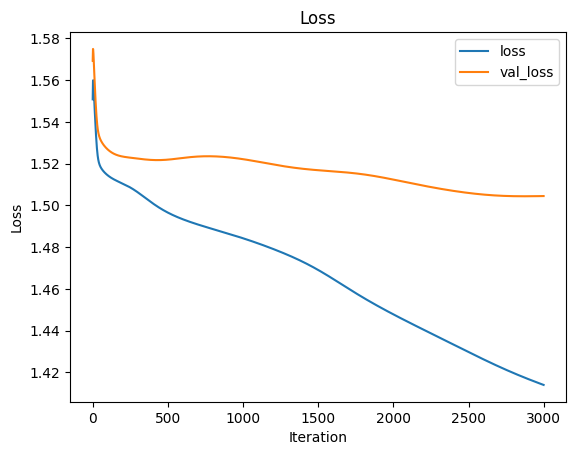

In [24]:
final_model = MLPClassifier(learning_rate=0.1, epochs=3000, activation='sigmoid', neurons = 10, optimizer='mbgd', mini_batch_size=20, hidden_layers=3)
final_model.fit(x_train, model.one_hot_encode(y_train), x_val,model.one_hot_encode(y_val))
final_model.plot_loss()

##### TESTING ON TEST SET

In [25]:
# Test and print the classification report on the test set.

print("Test Accuracy: {0:.4f}".format(accuracy_score(y_test, final_model.predict(x_test))))
y_pred = final_model.predict(x_test)
from sklearn.metrics import classification_report

print("classification report :")
print(classification_report(y_test, y_pred,zero_division=0))

Test Accuracy: 0.6114
classification report :
              precision    recall  f1-score   support

           1       0.00      0.00      0.00         6
           2       0.70      0.72      0.71        96
           3       0.57      0.61      0.59        99
           4       0.44      0.42      0.43        26
           5       0.00      0.00      0.00         2

    accuracy                           0.61       229
   macro avg       0.34      0.35      0.35       229
weighted avg       0.59      0.61      0.60       229



##### MULTI-LABEL CLASSIFICATION USING MLP

In [3]:
df = pd.read_csv('advertisement.csv')
labels = df['labels'].str.split(' ').explode().unique()
ad_data = df.values
ad_data = np.array(ad_data)

one_hot = OneHotEncoder()
one_hot.fit(ad_data[:, [1,3,4,6,7,9]])
one_hot_encoded = one_hot.transform(ad_data[:, [1,3,4,6,7,9]]).toarray()

scaler = StandardScaler()
scaler.fit(ad_data[:, [0,2,5,8]])
scaled = scaler.transform(ad_data[:, [0,2,5,8]])

normalizer = Normalizer()
scaled = normalizer.fit_transform(scaled)

ad_X = np.concatenate((one_hot_encoded, scaled), axis=1)

unique_labels = df['labels'].str.split(' ').explode().unique()
labels1 = df['labels'].str.split(' ').values
labels1 = np.array(labels1)

mlb = MultiLabelBinarizer()
ad_Y = mlb.fit_transform(labels1)

ad_X_train, ad_X_test, ad_Y_train, ad_Y_test = train_test_split(ad_X, ad_Y, test_size=0.2, random_state=42)
ad_X_train, ad_X_val, ad_Y_train, ad_Y_val = train_test_split(ad_X_train, ad_Y_train, test_size=0.1, random_state=42)

##### MODIFYING THE MODEL

In [5]:
class MLPClassifier_MultiLabel(MLPClassifier):
    def __init__(self, learning_rate=0.01, epochs=1000, activation='sigmoid', neurons = 10, optimizer='sgd', mini_batch_size=None, hidden_layers=1, verbose = True):
        super().__init__(learning_rate, epochs, activation, neurons, optimizer, mini_batch_size, hidden_layers, verbose)

    def forward(self, x):
        z = []
        for i in range(len(self.weights)):
            if i == 0:
                z.append(np.dot(x, self.weights[i]) + self.bias[i])
            else:
                z.append(np.dot(z[i-1], self.weights[i]) + self.bias[i])
            if i == len(self.weights) - 1:
                z[i] = self.sigmoid(z[i])
                break
            if self.activation == 'sigmoid':
                z[i] = self.sigmoid(z[i])
            elif self.activation == 'tanh':
                z[i] = self.tanh(z[i])
            elif self.activation == 'relu':
                z[i] = self.relu(z[i])
        return z
    
    def backward(self, x, y, z):
        grad_w = []
        grad_b = []
        for i in reversed(range(len(self.weights))):
            if i == len(self.weights) - 1:
                error = z[i] - y
                grad = error * self.gradient_sigmoid(z[i])
                grad_w.append(np.dot(z[i-1].T, grad))
                grad_b.append(np.sum(grad, axis=0, keepdims=True))
            elif i == 0:
                error = np.dot(grad, self.weights[i+1].T)
                if self.activation == 'sigmoid':
                    grad = error * self.gradient_sigmoid(z[i])
                elif self.activation == 'tanh':
                    grad = error * self.gradient_tanh(z[i])
                elif self.activation == 'relu':
                    grad = error * self.gradient_relu(z[i])
                grad_w.append(np.dot(x.T, grad))
                grad_b.append(np.sum(grad, axis=0, keepdims=True))
            else:
                error = np.dot(grad, self.weights[i+1].T)
                if self.activation == 'sigmoid':
                    grad = error * self.gradient_sigmoid(z[i])
                elif self.activation == 'tanh':
                    grad = error * self.gradient_tanh(z[i])
                elif self.activation == 'relu':
                    grad = error * self.gradient_relu(z[i])
                grad_w.append(np.dot(z[i-1].T, grad))
                grad_b.append(np.sum(grad, axis=0, keepdims=True))
        grad_w.reverse()
        grad_b.reverse()
        return grad_w, grad_b

    def cross_entropy_loss(self, x, y):
        z = self.forward(x)
        probs = z[-1]
        # if probs is close to 0 or 1, then clip it to avoid log(0) or log(1)
        probs = np.clip(probs, 1e-5, 1 - 1e-5)
        loss = -np.sum(y * np.log(probs) + (1 - y) * np.log(1 - probs)) / len(x)
        return loss
    
    def predict(self, x):
        z = self.forward(x)
        probs = z[-1]
        probs[probs > 0.5] = 1
        probs[probs <= 0.5] = 0
        return probs
    
    def hamming_loss(self, x, y):
        y_pred = self.predict(x)
        loss = np.sum(y_pred != y) / (y.shape[0] * y.shape[1])
        return loss
    
    def score(self, x, y):
        y_pred = self.predict(x)
        accuracy = np.sum(y_pred == y) / (y.shape[0] * y.shape[1])
        return accuracy

Iteration: 1, Loss: 39.6870, Accuracy: 0.4896, Val Loss: 37.9324, Val Accuracy: 0.5125
Iteration: 2, Loss: 28.1888, Accuracy: 0.5726, Val Loss: 30.2397, Val Accuracy: 0.5484
Iteration: 3, Loss: 21.8796, Accuracy: 0.5825, Val Loss: 24.0908, Val Accuracy: 0.5469
Iteration: 4, Loss: 16.5427, Accuracy: 0.6031, Val Loss: 16.8881, Val Accuracy: 0.5891
Iteration: 5, Loss: 6.5882, Accuracy: 0.6194, Val Loss: 6.5498, Val Accuracy: 0.6062
Iteration: 6, Loss: 5.5763, Accuracy: 0.6505, Val Loss: 5.8243, Val Accuracy: 0.6516
Iteration: 7, Loss: 5.4913, Accuracy: 0.6531, Val Loss: 5.7266, Val Accuracy: 0.6500
Iteration: 8, Loss: 5.4115, Accuracy: 0.6531, Val Loss: 5.6969, Val Accuracy: 0.6500
Iteration: 9, Loss: 5.3596, Accuracy: 0.6536, Val Loss: 5.5739, Val Accuracy: 0.6484
Iteration: 10, Loss: 5.3073, Accuracy: 0.6535, Val Loss: 5.5085, Val Accuracy: 0.6453
Iteration: 11, Loss: 5.3000, Accuracy: 0.6535, Val Loss: 5.5391, Val Accuracy: 0.6453
Iteration: 12, Loss: 5.2987, Accuracy: 0.6530, Val Loss

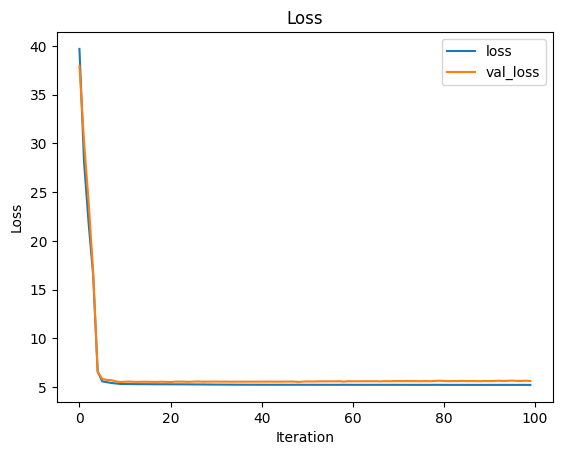

In [12]:
# train
model = MLPClassifier_MultiLabel(learning_rate=0.01, epochs=100, activation='relu', neurons = 10, optimizer='sgd', mini_batch_size=10, hidden_layers=3)
model.fit(ad_X_train, ad_Y_train, ad_X_val, ad_Y_val)
print("Train Accuracy: {0:.4f}".format(1-hamming_loss(ad_Y_val, model.predict(ad_X_val))))
model.plot_loss()

##### HYPERPARAMETER TUNING

In [6]:
# Hyperparametre tuning using sweeps
sweep_config = {
    'method': 'grid',
    'metric': {
        'name': 'Validation Accuracy',
        'goal': 'maximize'   
    },
    'parameters': {
        'activation': {
            'values': ['sigmoid', 'tanh', 'relu']
        },
        'optimizer': {
            'values': ['sgd', 'bgd', 'mbgd']
        },
    }
}

sweep_id = wandb.sweep(sweep_config, project="Q2_3")

def train():
    config_defaults = {
        'activation': 'sigmoid',
        'optimizer': 'sgd',
    }

    wandb.init(config=config_defaults)
    config = wandb.config

    model = MLPClassifier_MultiLabel(learning_rate=0.01, epochs=1000, activation=config.activation, neurons = 32, optimizer=config.optimizer, mini_batch_size=10, hidden_layers=1,verbose=False)
    model.fit(ad_X_train, ad_Y_train, ad_X_val, ad_Y_val)
    print("Validation Accuracy: {0:.4f}".format(model.score(ad_X_val, ad_Y_val)))
    wandb.log({"Activation": config.activation, "Optimizer": config.optimizer, "Validation Loss": model.cross_entropy_loss(ad_X_val, ad_Y_val), "Validation Accuracy": 1-model.hamming_loss(ad_X_val, ad_Y_val)})

wandb.agent(sweep_id, train)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Create sweep with ID: xw9w8715
Sweep URL: https://wandb.ai/shravya1051/Q2_3/sweeps/xw9w8715


wandb: Agent Starting Run: cv0l3oh1 with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: shravya1051. Use `wandb login --relogin` to force relogin


Validation Accuracy: 0.6828


Validation Accuracy,▁
Validation Loss,▁
Activation,sigmoid
Optimizer,sgd
Validation Accuracy,0.68281
Validation Loss,6.82833


wandb: Agent Starting Run: y1z5f1mj with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.5125


Validation Accuracy,▁
Validation Loss,▁
Activation,sigmoid
Optimizer,bgd
Validation Accuracy,0.5125
Validation Loss,7.80645


wandb: Agent Starting Run: 01w6kvbx with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.6703


Validation Accuracy,▁
Validation Loss,▁
Activation,sigmoid
Optimizer,mbgd
Validation Accuracy,0.67031
Validation Loss,5.30294


wandb: Agent Starting Run: 70vwoya2 with config:
wandb: 	activation: tanh
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.6672


Validation Accuracy,▁
Validation Loss,▁
Activation,tanh
Optimizer,sgd
Validation Accuracy,0.66719
Validation Loss,13.927


wandb: Agent Starting Run: gcenulg9 with config:
wandb: 	activation: tanh
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.5437


Validation Accuracy,▁
Validation Loss,▁
Activation,tanh
Optimizer,bgd
Validation Accuracy,0.54375
Validation Loss,15.82088


wandb: Agent Starting Run: 4cxw3g2b with config:
wandb: 	activation: tanh
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.6750


Validation Accuracy,▁
Validation Loss,▁
Activation,tanh
Optimizer,mbgd
Validation Accuracy,0.675
Validation Loss,7.03609


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: g487hk3a with config:
wandb: 	activation: relu
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.6781


Validation Accuracy,▁
Validation Loss,▁
Activation,relu
Optimizer,sgd
Validation Accuracy,0.67812
Validation Loss,17.61741


wandb: Agent Starting Run: yycuz2y0 with config:
wandb: 	activation: relu
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.5594


Validation Accuracy,▁
Validation Loss,▁
Activation,relu
Optimizer,bgd
Validation Accuracy,0.55937
Validation Loss,22.04221


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 9icx4zlb with config:
wandb: 	activation: relu
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Accuracy: 0.6125


Validation Accuracy,▁
Validation Loss,▁
Activation,relu
Optimizer,mbgd
Validation Accuracy,0.6125
Validation Loss,16.44609


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [35]:
# Hyperparameter tuning using W&B
wandb.init(project="Q2_4_1",entity="shravya1051")

activations = ['sigmoid', 'tanh', 'relu']
optimizers = ['sgd', 'bgd', 'mbgd']

for activation in activations:
    for optimizer in optimizers:
        model = MLPClassifier_MultiLabel(learning_rate=0.01, epochs=1000, activation=activation, neurons = 32, optimizer=optimizer, mini_batch_size=10, hidden_layers=1,verbose=False)
        model.fit(ad_X_train, ad_Y_train, ad_X_val, ad_Y_val)
        print("Activation: {0}, Optimizer: {1}".format(activation, optimizer))
        print("Validation Accuracy: {0:.4f}".format(1 - hamming_loss(ad_Y_val, model.predict(ad_X_val))))
        print("Validation Precision: {0:.4f}".format(precision_score(ad_Y_val, model.predict(ad_X_val), average='macro',zero_division=0)))
        print("Validation Recall: {0:.4f}".format(recall_score(ad_Y_val, model.predict(ad_X_val), average='macro',zero_division=0)))
        print("Validation F1: {0:.4f}".format(f1_score(ad_Y_val, model.predict(ad_X_val), average='macro',zero_division=0)))
        loss = model.cross_entropy_loss(ad_X_val, ad_Y_val)
        wandb.log({"Activation": activation, "Optimizer": optimizer,"Validation loss": loss,"Validation Accuracy": 1 - hamming_loss(ad_Y_val, model.predict(ad_X_val))})

Validation Accuracy,▆▃▇▇▁▇█▁▆
Validation loss,▂▂▁▄▅▂▆█▇
Activation,relu
Optimizer,mbgd
Validation Accuracy,0.62969
Validation loss,20.29617


Activation: sigmoid, Optimizer: sgd
Validation Accuracy: 0.6844
Validation Precision: 0.5486
Validation Recall: 0.5205
Validation F1: 0.5277
Activation: sigmoid, Optimizer: bgd
Validation Accuracy: 0.5828
Validation Precision: 0.3056
Validation Recall: 0.2232
Validation F1: 0.2432
Activation: sigmoid, Optimizer: mbgd
Validation Accuracy: 0.6875
Validation Precision: 0.5827
Validation Recall: 0.3253
Validation F1: 0.4117
Activation: tanh, Optimizer: sgd
Validation Accuracy: 0.6531
Validation Precision: 0.4933
Validation Recall: 0.4437
Validation F1: 0.4616
Activation: tanh, Optimizer: bgd
Validation Accuracy: 0.5141
Validation Precision: 0.3494
Validation Recall: 0.5006
Validation F1: 0.4009
Activation: tanh, Optimizer: mbgd
Validation Accuracy: 0.6297
Validation Precision: 0.4583
Validation Recall: 0.3688
Validation F1: 0.3975
Activation: relu, Optimizer: sgd
Validation Accuracy: 0.6516
Validation Precision: 0.4922
Validation Recall: 0.4581
Validation F1: 0.4692
Activation: relu, Optim

In [36]:
# keeping activation function, optimizer constant

wandb.init(project="Q2_4_2",entity="shravya1051")

# changing learning rate, epochs,mini_batch_size, no.of layers and hidden neurons
learning_rates = [0.1,0.01, 0.001]
epochs = [1000, 2000, 3000]
mini_batch_sizes = [10, 20, 30]
hidden_layers = [1, 2, 3]
neurons = [10, 32, 64]
activation = 'sigmoid'
optimizer = 'sgd'

for lr in learning_rates:
    for epoch in epochs:
        for hidden_layer in hidden_layers:
            for neuron in neurons:
                for mini_batch_size in mini_batch_sizes:
                    model = MLPClassifier_MultiLabel(learning_rate=lr, epochs=epoch, activation=activation, neurons = neuron, optimizer=optimizer, mini_batch_size=mini_batch_size, hidden_layers=hidden_layer,verbose=False)
                    model.fit(ad_X_train, ad_Y_train, ad_X_val, ad_Y_val)
                    print("Learning Rate: {0}, Epochs: {1}, Mini Batch Size: {2}, Hidden Layers: {3}, Neurons: {4}".format(lr, epoch, mini_batch_size, hidden_layer, neuron))
                    print("Validation Accuracy: {0:.4f}".format(1 - hamming_loss(ad_Y_val, model.predict(ad_X_val))))
                    print("Validation Precision: {0:.4f}".format(precision_score(ad_Y_val, model.predict(ad_X_val), average='macro',zero_division=0)))
                    print("Validation Recall: {0:.4f}".format(recall_score(ad_Y_val, model.predict(ad_X_val), average='macro',zero_division=0)))
                    print("Validation F1: {0:.4f}".format(f1_score(ad_Y_val, model.predict(ad_X_val), average='macro',zero_division=0)))
                    loss = model.cross_entropy_loss(ad_X_val, ad_Y_val)
                    wandb.log({"Learning Rate": lr, "Epochs": epoch, "Mini Batch Size": mini_batch_size, "Hidden Layers": hidden_layer, "Neurons": neuron, "Validation Accuracy": 1-hamming_loss(ad_Y_val, model.predict(ad_X_val)), "Validation loss": loss})                

Validation Accuracy,█▄█▇▁▆▇▁▇
Validation loss,▂▂▁▄▅▂▅█▅
Activation,relu
Optimizer,mbgd
Validation Accuracy,0.67188
Validation loss,16.07848


Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 10, Hidden Layers: 1, Neurons: 10
Validation Accuracy: 0.7031
Validation Precision: 0.5782
Validation Recall: 0.4876
Validation F1: 0.5236
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 20, Hidden Layers: 1, Neurons: 10
Validation Accuracy: 0.7297
Validation Precision: 0.6622
Validation Recall: 0.4227
Validation F1: 0.5112
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 30, Hidden Layers: 1, Neurons: 10
Validation Accuracy: 0.6766
Validation Precision: 0.5397
Validation Recall: 0.3329
Validation F1: 0.4070
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 10, Hidden Layers: 1, Neurons: 32
Validation Accuracy: 0.6609
Validation Precision: 0.5030
Validation Recall: 0.4635
Validation F1: 0.4772
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size: 20, Hidden Layers: 1, Neurons: 32
Validation Accuracy: 0.6891
Validation Precision: 0.5676
Validation Recall: 0.4758
Validation F1: 0.5104
Learning Rate: 0.1, Epochs: 1000, Mini Batch Size:

##### METRICS ON TEST DATA

Iteration: 1, Loss: 8.5339, Accuracy: 0.4925, Val Loss: 8.1688, Val Accuracy: 0.4891
Iteration: 2, Loss: 7.6588, Accuracy: 0.5271, Val Loss: 7.2285, Val Accuracy: 0.5484
Iteration: 3, Loss: 7.1163, Accuracy: 0.5509, Val Loss: 6.6637, Val Accuracy: 0.5906
Iteration: 4, Loss: 6.6887, Accuracy: 0.5637, Val Loss: 6.2491, Val Accuracy: 0.6156
Iteration: 5, Loss: 6.2836, Accuracy: 0.5712, Val Loss: 5.8802, Val Accuracy: 0.6219
Iteration: 6, Loss: 5.9717, Accuracy: 0.5830, Val Loss: 5.6148, Val Accuracy: 0.6344
Iteration: 7, Loss: 5.8094, Accuracy: 0.5960, Val Loss: 5.4948, Val Accuracy: 0.6328
Iteration: 8, Loss: 5.7399, Accuracy: 0.6040, Val Loss: 5.4584, Val Accuracy: 0.6422
Iteration: 9, Loss: 5.7062, Accuracy: 0.6104, Val Loss: 5.4501, Val Accuracy: 0.6422
Iteration: 10, Loss: 5.6840, Accuracy: 0.6122, Val Loss: 5.4478, Val Accuracy: 0.6344
Iteration: 11, Loss: 5.6650, Accuracy: 0.6139, Val Loss: 5.4448, Val Accuracy: 0.6406
Iteration: 12, Loss: 5.6467, Accuracy: 0.6163, Val Loss: 5.4396

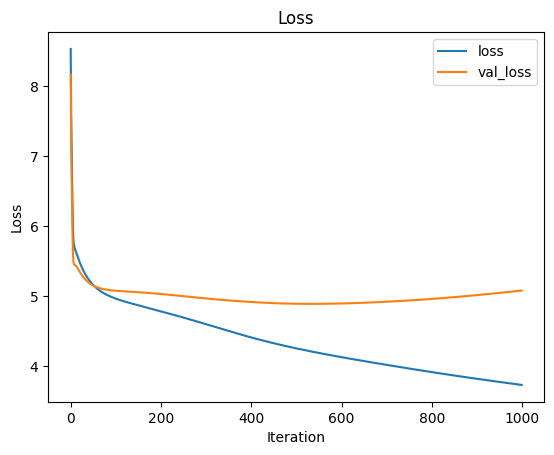

In [14]:
model = MLPClassifier_MultiLabel(learning_rate=0.1, epochs=1000, activation='sigmoid', neurons = 10, optimizer='mbgd', mini_batch_size=20, hidden_layers=1)
model.fit(ad_X_train, ad_Y_train, ad_X_val, ad_Y_val)
model.plot_loss()

In [33]:
# print classification report on test set and accuracy
print("Test Accuracy: {0:.4f}".format(1-hamming_loss(ad_Y_test, model.predict(ad_X_test))))
print("Precision : {0:.4f}".format(precision_score(ad_Y_test, model.predict(ad_X_test), average='macro',zero_division=0)))
print("Recall : {0:.4f}".format(recall_score(ad_Y_test, model.predict(ad_X_test), average='macro',zero_division=0)))
print("F1 : {0:.4f}".format(f1_score(ad_Y_test, model.predict(ad_X_test), average='macro',zero_division=0)))

Test Accuracy: 0.7344
Precision : 0.6398
Recall : 0.4529
F1 : 0.5281


### PART 3

##### DATA PREPROCESSING

In [7]:
df = pd.read_csv('HousingData.csv')
print(df.describe())

             CRIM          ZN       INDUS        CHAS         NOX          RM  \
count  486.000000  486.000000  486.000000  486.000000  506.000000  506.000000   
mean     3.611874   11.211934   11.083992    0.069959    0.554695    6.284634   
std      8.720192   23.388876    6.835896    0.255340    0.115878    0.702617   
min      0.006320    0.000000    0.460000    0.000000    0.385000    3.561000   
25%      0.081900    0.000000    5.190000    0.000000    0.449000    5.885500   
50%      0.253715    0.000000    9.690000    0.000000    0.538000    6.208500   
75%      3.560263   12.500000   18.100000    0.000000    0.624000    6.623500   
max     88.976200  100.000000   27.740000    1.000000    0.871000    8.780000   

              AGE         DIS         RAD         TAX     PTRATIO           B  \
count  486.000000  506.000000  506.000000  506.000000  506.000000  506.000000   
mean    68.518519    3.795043    9.549407  408.237154   18.455534  356.674032   
std     27.999513    2.1057

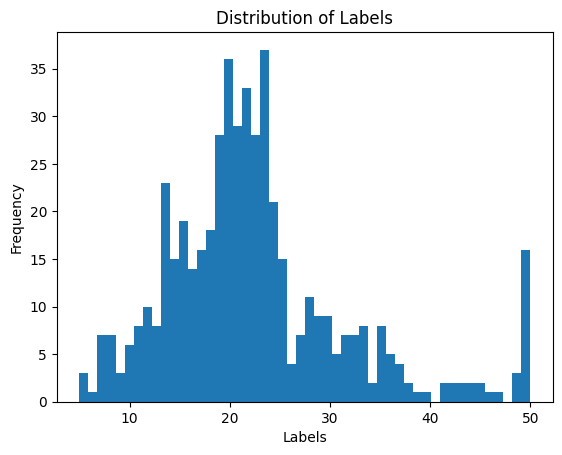

In [8]:
labels = df['MEDV'].values
plt.hist(labels, bins=50)
plt.title("Distribution of Labels")
plt.xlabel("Labels")
plt.ylabel("Frequency")
plt.show()

In [9]:
x = df.drop(columns=['MEDV']).values
from sklearn.impute import SimpleImputer
# Handling missing values
imputer = SimpleImputer()
x = imputer.fit_transform(x)

scaler = StandardScaler()
x = scaler.fit_transform(x)

normalizer = Normalizer()
x = normalizer.fit_transform(x)
print(x.shape)

(506, 13)


In [10]:
X_train, X_test, y_train, y_test = train_test_split(x, labels, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)
# reshape y_train, y_test, y_val
y_train = y_train.reshape(-1, 1)
y_test = y_test.reshape(-1, 1)
y_val = y_val.reshape(-1, 1)

##### MLP REGRESSION MODEL

In [11]:
class MLPRegressor:
    def __init__(self, learning_rate=0.01, epochs=1000, activation='sigmoid', neurons = 10, optimizer='sgd', mini_batch_size=None, hidden_layers=1, verbose = True):
        self.learning_rate = learning_rate
        self.epochs = epochs
        self.activation = activation
        self.neurons = neurons
        self.loss = []
        self.val_loss = []
        self.weights = []
        self.bias = []
        self.optimizer = optimizer
        self.mini_batch_size = mini_batch_size
        self.hidden_layers = hidden_layers
        self.verbose = verbose

    # activation functions

    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))
    
    def tanh(self, x):
        return np.tanh(x)
    
    def relu(self, x):
        return np.maximum(0, x)
    
    def gradient_sigmoid(self, x):
        return x * (1 - x)
    
    def gradient_tanh(self, x):
        return 1 - (x ** 2)
    
    def gradient_relu(self, x):
        return 1 * (x > 0)
    
    # optimizer functions

    def sgd(self, x, y):
        for i in range(len(x)):
            x_reshaped = x[i].reshape(1, -1)
            z = self.forward(x_reshaped)
            grad_w, grad_b = self.backward(x_reshaped, y[i], z)
            self.update_weights(x_reshaped, grad_w)
            self.update_bias(x_reshaped,grad_b)
    
    def bgd(self, x, y):
        z = self.forward(x)
        grad_w, grad_b = self.backward(x, y, z)
        self.update_weights(x, grad_w)
        self.update_bias(x,grad_b)

    def mbgd(self, x, y):
        for i in range(0, len(x), self.mini_batch_size):
            z = self.forward(x[i:i+self.mini_batch_size])
            grad_w, grad_b = self.backward(x[i:i+self.mini_batch_size], y[i:i+self.mini_batch_size], z)
            self.update_weights(x[i:i+self.mini_batch_size], grad_w)
            self.update_bias(x[i:i+self.mini_batch_size], grad_b)

    # forward and backward pass
    
    def forward(self, x):
        z = []
        for i in range(len(self.weights)):
            if i == 0:
                z.append(np.dot(x, self.weights[i]) + self.bias[i])
            else:
                z.append(np.dot(z[i-1], self.weights[i]) + self.bias[i])
            if i == len(self.weights) - 1:
                z[i] = self.relu(z[i])
                break
            if self.activation == 'sigmoid':
                z[i] = self.sigmoid(z[i])
            elif self.activation == 'tanh':
                z[i] = self.tanh(z[i])
            elif self.activation == 'relu':
                z[i] = self.relu(z[i])
        return z
    
    def backward(self, x, y, z):
        grad_w = []
        grad_b = []
        for i in reversed(range(len(self.weights))):
            if i == len(self.weights) - 1:
                error = z[i] - y
                grad = error * self.gradient_relu(z[i])
                grad_w.append(np.dot(z[i-1].T, error))
                grad_b.append(np.sum(error, axis=0, keepdims=True))
            elif i == 0:
                error = np.dot(grad, self.weights[i+1].T)
                if self.activation == 'sigmoid':
                    grad = error * self.gradient_sigmoid(z[i])
                elif self.activation == 'tanh':
                    grad = error * self.gradient_tanh(z[i])
                elif self.activation == 'relu':
                    grad = error * self.gradient_relu(z[i])
                grad_w.append(np.dot(x.T, grad))
                grad_b.append(np.sum(grad, axis=0, keepdims=True))
            else:
                error = np.dot(grad, self.weights[i+1].T)
                if self.activation == 'sigmoid':
                    grad = error * self.gradient_sigmoid(z[i])
                elif self.activation == 'tanh':
                    grad = error * self.gradient_tanh(z[i])
                elif self.activation == 'relu':
                    grad = error * self.gradient_relu(z[i])
                grad_w.append(np.dot(z[i-1].T, grad))
                grad_b.append(np.sum(grad, axis=0, keepdims=True))
        grad_w.reverse()
        grad_b.reverse()
        return grad_w, grad_b
    
    # update weights and bias

    def update_weights(self, x, grad_w):
        for i in range(len(self.weights)):
            self.weights[i] -= self.learning_rate * grad_w[i]/len(x)
    
    def update_bias(self, x, grad_b):
        for i in range(len(self.bias)):
            self.bias[i] -= self.learning_rate * grad_b[i]/len(x)

    # fit and predict

    def fit(self, x, y, x_val, y_val):
        n_features = x.shape[1]
        # multiple hidden layers
        for i in range(self.hidden_layers):
            if i == 0:
                self.weights.append(np.random.randn(n_features, self.neurons))
                self.bias.append(np.zeros((1, self.neurons)))
            else:
                self.weights.append(np.random.randn(self.neurons, self.neurons))
                self.bias.append(np.zeros((1, self.neurons)))
        self.weights.append(np.random.randn(self.neurons, 1))
        self.bias.append(np.zeros((1, 1)))
        for i in range(self.epochs):
            if self.optimizer == 'sgd':
                self.sgd(x, y)
            elif self.optimizer == 'bgd':
                self.bgd(x, y)
            elif self.optimizer == 'mbgd':
                self.mbgd(x, y)
            else:
                raise ValueError("Optimizer must be 'sgd', 'bgd', or 'mbgd'")
            
            loss = self.mse_loss(x, y)
            val_loss = self.mse_loss(x_val, y_val)
            self.loss.append(loss)
            self.val_loss.append(val_loss)
            if self.verbose:
                print("Iteration: {0}, Loss: {1:.4f}, Val Loss: {2:.4f}".format(i+1, loss, val_loss))
        return self
    
    def predict(self, x):
        return self.forward(x)[-1]
    
    def mse_loss(self, x, y):
        y_pred = self.predict(x)
        loss = np.mean(1/2*(y_pred - y) ** 2)
        return loss

    def plot_loss(self):
        plt.plot(self.loss, label='loss')
        plt.plot(self.val_loss, label='val_loss')
        plt.title("Loss")
        plt.xlabel("Iteration")
        plt.ylabel("Loss")
        plt.legend()
        plt.show()

Iteration: 1, Loss: 34.6176, Val Loss: 22.2038
Iteration: 2, Loss: 27.3745, Val Loss: 15.5903
Iteration: 3, Loss: 23.5645, Val Loss: 12.3963
Iteration: 4, Loss: 21.1826, Val Loss: 10.5633
Iteration: 5, Loss: 19.5396, Val Loss: 9.4137
Iteration: 6, Loss: 18.3559, Val Loss: 8.6844
Iteration: 7, Loss: 17.4850, Val Loss: 8.2358
Iteration: 8, Loss: 16.8312, Val Loss: 7.9744
Iteration: 9, Loss: 16.3278, Val Loss: 7.8339
Iteration: 10, Loss: 15.9278, Val Loss: 7.7687
Iteration: 11, Loss: 15.5991, Val Loss: 7.7485
Iteration: 12, Loss: 15.3198, Val Loss: 7.7539
Iteration: 13, Loss: 15.0751, Val Loss: 7.7726
Iteration: 14, Loss: 14.8553, Val Loss: 7.7970
Iteration: 15, Loss: 14.6539, Val Loss: 7.8226
Iteration: 16, Loss: 14.4663, Val Loss: 7.8468
Iteration: 17, Loss: 14.2898, Val Loss: 7.8682
Iteration: 18, Loss: 14.1222, Val Loss: 7.8862
Iteration: 19, Loss: 13.9622, Val Loss: 7.9005
Iteration: 20, Loss: 13.8086, Val Loss: 7.9112
Iteration: 21, Loss: 13.6609, Val Loss: 7.9185
Iteration: 22, Los

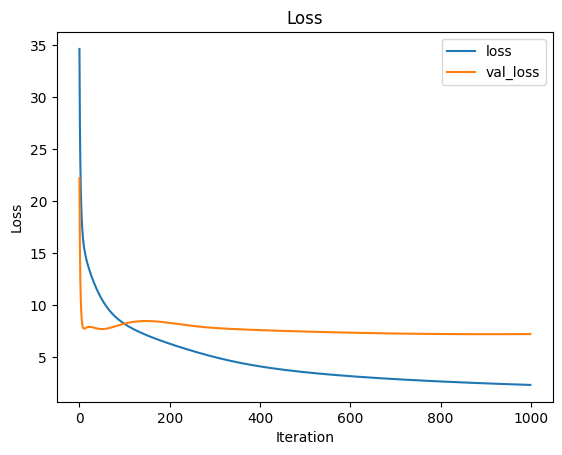

In [43]:
# train
model = MLPRegressor(learning_rate=0.01, epochs=1000, activation='sigmoid', neurons = 32, optimizer='mbgd', mini_batch_size=10, hidden_layers=1)
model.fit(X_train, y_train, X_val, y_val)
model.plot_loss()

##### HYPERPARAMETER TUNING

In [12]:
# hyperparameter tuning using sweeps
sweep_config = {
    'method': 'grid',
    'metric': {
        'name': 'Validation Loss',
        'goal': 'minimize'   
    },
    'parameters': {
        'activation': {
            'values': ['sigmoid', 'tanh', 'relu']
        },
        'optimizer': {
            'values': ['sgd', 'bgd', 'mbgd']
        },
    }
}

sweep_id = wandb.sweep(sweep_config, project="Q3_5")

def train():
    config_defaults = {
        'activation': 'sigmoid',
        'optimizer': 'sgd',
    }

    wandb.init(config=config_defaults)
    config = wandb.config

    model = MLPRegressor(learning_rate=0.01, epochs=500, activation=config.activation, neurons = 32, optimizer=config.optimizer, mini_batch_size=10, hidden_layers=1,verbose=False)
    model.fit(X_train, y_train, X_val, y_val)
    print("Validation Loss: {0:.4f}".format(model.mse_loss(X_val, y_val)))
    wandb.log({"Activation": config.activation, "Optimizer": config.optimizer, "Validation Loss": model.mse_loss(X_val, y_val),"Validation R2 Score": r2_score(y_val, model.predict(X_val)), "Validation RMSE": np.sqrt(mean_squared_error(y_val, model.predict(X_val)))})

wandb.agent(sweep_id, train)

Create sweep with ID: fc9ffp56
Sweep URL: https://wandb.ai/shravya1051/Q3_5/sweeps/fc9ffp56


wandb: Agent Starting Run: ikzptqey with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 7.4801


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,sigmoid
Optimizer,sgd
Validation Loss,7.48014
Validation R2 Score,0.77165
Validation RMSE,3.86785


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 4642120f with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 7.3933


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,sigmoid
Optimizer,bgd
Validation Loss,7.39327
Validation R2 Score,0.7743
Validation RMSE,3.84533


wandb: Agent Starting Run: f3vkronx with config:
wandb: 	activation: sigmoid
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 8.6390


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,sigmoid
Optimizer,mbgd
Validation Loss,8.63905
Validation R2 Score,0.73627
Validation RMSE,4.15669


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: s4es7ocg with config:
wandb: 	activation: tanh
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 10.4689


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,tanh
Optimizer,sgd
Validation Loss,10.46891
Validation R2 Score,0.68041
Validation RMSE,4.57579


wandb: Agent Starting Run: 3ke3ohaq with config:
wandb: 	activation: tanh
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 7.0917


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,tanh
Optimizer,bgd
Validation Loss,7.09173
Validation R2 Score,0.7835
Validation RMSE,3.76609


wandb: Agent Starting Run: ianvjvv1 with config:
wandb: 	activation: tanh
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 11.8625


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,tanh
Optimizer,mbgd
Validation Loss,11.86252
Validation R2 Score,0.63786
Validation RMSE,4.87083


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: q9kt48q3 with config:
wandb: 	activation: relu
wandb: 	optimizer: sgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 7.9996


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,relu
Optimizer,sgd
Validation Loss,7.99965
Validation R2 Score,0.75579
Validation RMSE,3.99991


wandb: Agent Starting Run: oi4uztb2 with config:
wandb: 	activation: relu
wandb: 	optimizer: bgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 7.5663


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,relu
Optimizer,bgd
Validation Loss,7.56632
Validation R2 Score,0.76902
Validation RMSE,3.89007


wandb: Agent Starting Run: aornbso8 with config:
wandb: 	activation: relu
wandb: 	optimizer: mbgd
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


Validation Loss: 7.5481


Validation Loss,▁
Validation R2 Score,▁
Validation RMSE,▁
Activation,relu
Optimizer,mbgd
Validation Loss,7.54807
Validation R2 Score,0.76957
Validation RMSE,3.88537


wandb: Sweep Agent: Waiting for job.
wandb: Sweep Agent: Exiting.


In [44]:
import wandb

activations = ['sigmoid', 'tanh', 'relu']
optimizers = ['sgd', 'bgd', 'mbgd']

wandb.init(project="Q3_1",entity="shravya1051")

for activation in activations:
    for optimizer in optimizers:
        model = MLPRegressor(learning_rate=0.01, epochs=500, activation=activation, neurons = 32, optimizer=optimizer, mini_batch_size=10, hidden_layers=1,verbose=False)
        model.fit(X_train, y_train, X_val, y_val)
        print("Activation: {0}, Optimizer: {1}".format(activation, optimizer))
        print("Validation Loss: {0:.4f}".format(model.mse_loss(X_val, y_val)))
        print("Validation R2 Score: {0:.4f}".format(r2_score(y_val, model.predict(X_val))))
        print("Validation RMSE: {0:.4f}".format(np.sqrt(mean_squared_error(y_val, model.predict(X_val)))))
        wandb.log({"Activation": activation, "Optimizer": optimizer,"Validation loss": model.mse_loss(X_val, y_val),"Validation R2 Score": r2_score(y_val, model.predict(X_val)), "Validation RMSE": np.sqrt(mean_squared_error(y_val, model.predict(X_val)))})

Epochs,▁▁▁▁▁
Hidden Layers,▁▁▁██
Learning Rate,▁▁▁▁▁
Neurons,▁▄█▁▄
Validation R2 Score,█▇▆▁▃
Validation RMSE,▁▃▃█▆
Validation loss,▁▂▃█▆
Epochs,1000
Hidden Layers,2
Learning Rate,0.1
Neurons,32


Activation: sigmoid, Optimizer: sgd
Validation Loss: 8.5910
Validation R2 Score: 0.7377
Validation RMSE: 4.1451
Activation: sigmoid, Optimizer: bgd
Validation Loss: 7.7612
Validation R2 Score: 0.7631
Validation RMSE: 3.9398
Activation: sigmoid, Optimizer: mbgd
Validation Loss: 7.5856
Validation R2 Score: 0.7684
Validation RMSE: 3.8950
Activation: tanh, Optimizer: sgd
Validation Loss: 14.5671
Validation R2 Score: 0.5553
Validation RMSE: 5.3976
Activation: tanh, Optimizer: bgd
Validation Loss: 6.1581
Validation R2 Score: 0.8120
Validation RMSE: 3.5094
Activation: tanh, Optimizer: mbgd
Validation Loss: 11.9795
Validation R2 Score: 0.6343
Validation RMSE: 4.8948
Activation: relu, Optimizer: sgd
Validation Loss: 10.0615
Validation R2 Score: 0.6928
Validation RMSE: 4.4859
Activation: relu, Optimizer: bgd
Validation Loss: 8.4604
Validation R2 Score: 0.7417
Validation RMSE: 4.1135
Activation: relu, Optimizer: mbgd
Validation Loss: 7.6939
Validation R2 Score: 0.7651
Validation RMSE: 3.9227


In [45]:
activation = 'tanh'
optimizer = 'bgd'

learning_rates = [0.1,0.01, 0.001]
epochs = [500, 1000, 1500]
hidden_layers = [1, 2, 3]
neurons = [10, 32, 64]

wandb.init(project="Q3_2",entity="shravya1051")

for lr in learning_rates:
    for epoch in epochs:
        for hidden_layer in hidden_layers:
            for neuron in neurons:
                model = MLPRegressor(learning_rate=lr, epochs=epoch, activation=activation, neurons = neuron, optimizer=optimizer, mini_batch_size=10, hidden_layers=hidden_layer,verbose=False)
                model.fit(X_train, y_train, X_val, y_val)
                print("Learning Rate: {0}, Epochs: {1}, Hidden Layers: {2}, Neurons: {3}".format(lr, epoch, hidden_layer, neuron))
                print("Validation Loss: {0:.4f}".format(model.mse_loss(X_val, y_val)))
                print("Validation R2 Score: {0:.4f}".format(r2_score(y_val, model.predict(X_val))))
                print("Validation RMSE: {0:.4f}".format(np.sqrt(mean_squared_error(y_val, model.predict(X_val)))))
                wandb.log({"Learning Rate": lr, "Epochs": epoch, "Hidden Layers": hidden_layer, "Neurons": neuron, "Validation loss": model.mse_loss(X_val, y_val),"Validation R2 Score": r2_score(y_val, model.predict(X_val)), "Validation RMSE": np.sqrt(mean_squared_error(y_val, model.predict(X_val)))})

Validation R2 Score,▆▇▇▁█▃▅▆▇
Validation RMSE,▃▃▂█▁▆▅▃▃
Validation loss,▃▂▂█▁▆▄▃▂
Activation,relu
Optimizer,mbgd
Validation R2 Score,0.76512
Validation RMSE,3.92272
Validation loss,7.69387


Learning Rate: 0.1, Epochs: 500, Hidden Layers: 1, Neurons: 10
Validation Loss: 9.1738
Validation R2 Score: 0.7199
Validation RMSE: 4.2834
Learning Rate: 0.1, Epochs: 500, Hidden Layers: 1, Neurons: 32
Validation Loss: 7.6045
Validation R2 Score: 0.7678
Validation RMSE: 3.8999
Learning Rate: 0.1, Epochs: 500, Hidden Layers: 1, Neurons: 64
Validation Loss: 8.2092
Validation R2 Score: 0.7494
Validation RMSE: 4.0520
Learning Rate: 0.1, Epochs: 500, Hidden Layers: 2, Neurons: 10
Validation Loss: 21.4695
Validation R2 Score: 0.3446
Validation RMSE: 6.5528
Learning Rate: 0.1, Epochs: 500, Hidden Layers: 2, Neurons: 32
Validation Loss: 8.0143
Validation R2 Score: 0.7553
Validation RMSE: 4.0036
Learning Rate: 0.1, Epochs: 500, Hidden Layers: 2, Neurons: 64
Validation Loss: 12.1853
Validation R2 Score: 0.6280
Validation RMSE: 4.9367
Learning Rate: 0.1, Epochs: 500, Hidden Layers: 3, Neurons: 10
Validation Loss: 10.1610
Validation R2 Score: 0.6898
Validation RMSE: 4.5080
Learning Rate: 0.1, Epoc

Iteration: 1, Loss: 117.4335, Val Loss: 89.2069
Iteration: 2, Loss: 74.0725, Val Loss: 60.6295
Iteration: 3, Loss: 51.7635, Val Loss: 41.2635
Iteration: 4, Loss: 40.3993, Val Loss: 28.9307
Iteration: 5, Loss: 33.3807, Val Loss: 23.0487
Iteration: 6, Loss: 29.0483, Val Loss: 20.2075
Iteration: 7, Loss: 26.1604, Val Loss: 18.8042
Iteration: 8, Loss: 23.8248, Val Loss: 17.8769
Iteration: 9, Loss: 21.9097, Val Loss: 16.9103
Iteration: 10, Loss: 20.2979, Val Loss: 16.1413
Iteration: 11, Loss: 18.9385, Val Loss: 15.6015
Iteration: 12, Loss: 17.8678, Val Loss: 15.2675
Iteration: 13, Loss: 16.9912, Val Loss: 15.0219
Iteration: 14, Loss: 16.2571, Val Loss: 14.8277
Iteration: 15, Loss: 15.6308, Val Loss: 14.6603
Iteration: 16, Loss: 15.0879, Val Loss: 14.5033
Iteration: 17, Loss: 14.6106, Val Loss: 14.3474
Iteration: 18, Loss: 14.1862, Val Loss: 14.1890
Iteration: 19, Loss: 13.8054, Val Loss: 14.0276
Iteration: 20, Loss: 13.4607, Val Loss: 13.8643
Iteration: 21, Loss: 13.1464, Val Loss: 13.7007


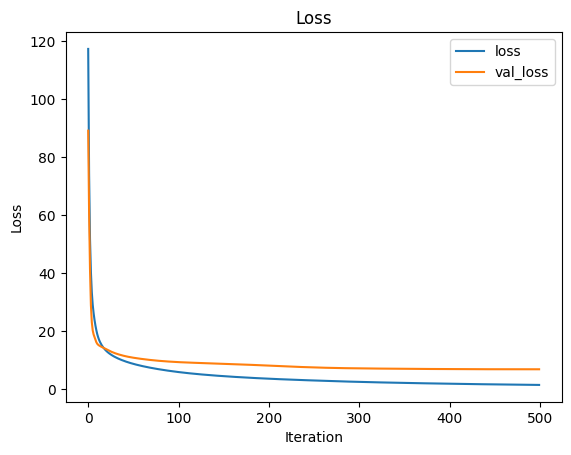

In [48]:
# best parameters Learning Rate: 0.01, Epochs: 500, Hidden Layers: 2, Neurons: 64 activation = 'tanh' optimizer = 'bgd'

model = MLPRegressor(learning_rate=0.01, epochs=500, activation='tanh', neurons = 64, optimizer='bgd', mini_batch_size=10, hidden_layers=2)
model.fit(X_train, y_train, X_val, y_val)
model.plot_loss()

In [49]:
# metrics on test set
print("Test Loss: {0:.4f}".format(model.mse_loss(X_test, y_test)))
print("Test R2 Score: {0:.4f}".format(r2_score(y_test, model.predict(X_test))))
print("Test RMSE: {0:.4f}".format(np.sqrt(mean_squared_error(y_test, model.predict(X_test)))))

Test Loss: 10.1384
Test R2 Score: 0.7235
Test RMSE: 4.5030
